# AS1063
## Find the best threshold for clump detection

Here we take the full cube and try to find clumps in empty regions close to the object (ie. false positives). This will help establish the limits on the dendrograms parameters

In [1]:
%matplotlib notebook
import matplotlib.pylab as plt
from matplotlib.patches import Ellipse
from matplotlib.patches import Polygon
from matplotlib.path import Path

import seaborn as sns
sns.set(style="whitegrid")
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

import warnings
warnings.filterwarnings('ignore')

import numpy as np

from scipy.ndimage import filters

from astropy.io import fits
from astropy import units as u
from astropy.stats import sigma_clipped_stats
from astropy.table import Table,Column
from astropy.wcs import WCS
from astropy.modeling import models, fitting

from reproject import reproject_interp

from astrodendro import Dendrogram, ppv_catalog
from astrodendro.analysis import PPVStatistic

from astropy.cosmology import WMAP9 as cosmo

## Load data and get observations properties

In [2]:
# ALMA 2D moments
header_alma = fits.getheader('../Data/Moments/as1063_mom0.fits')
wcs_alma =  WCS(header_alma)
wcs_alma.wcs.crpix = wcs_alma.wcs.crpix - [400,400] # to compensate the cropping
mom0 = fits.getdata('../Data/Moments/as1063_mom0.fits')[400:950,400:950]
mom1 = fits.getdata('../Data/Moments/as1063_mom1.fits')[400:950,400:950]
alma = fits.open('../Data/Moments/as1063_mom0.fits')[0]

# HST imaging
HST_red,_ = reproject_interp('../Data/HST/AS1063_F160w.fits',alma.header)
HST_green,_ = reproject_interp('../Data/HST/AS1063_F814w.fits',alma.header)
HST_blue,_ = reproject_interp('../Data/HST/AS1063_F435w.fits',alma.header)
hst_im = fits.getdata('../Data/HST/as1063_hst_606_big_aligned_with_alma.fits')[400:950,400:950]

# Velocity model from MUSE, just for plotting
oii_vel, _ = reproject_interp('../Data/MUSE/AS1063_model_atan.fits',alma.header)
oii_vel[np.where(oii_vel == 0)] = np.nan
oii_vel = oii_vel[400:950,400:950]

# ALMA cube
alma_data = fits.getdata('../Data/Cubes/AS1063_A_a_07_TM1_CO_4-3.image.pbcor.fits')[0] # Hz,pix,pix 
wcs_cube = WCS(fits.getheader('../Data/Cubes/AS1063_A_a_07_TM1_CO_4-3.image.pbcor.fits'))
wcs_cube = wcs_cube.dropaxis(3)
wcs_cube.wcs.crpix = wcs_cube.wcs.crpix - [400,400,10] # to compensate the cropping
crop_data = alma_data[10:30,400:950,400:950]# Cut also in spectral window in the same way we cut for the mom0
alma_im = np.nanmean(crop_data,axis=0)

Channel width

In [3]:
from astropy.constants import c

def channel_width(file):
    wcs  = fits.getheader(file)
    print(-wcs['CDELT3']/wcs['CRVAL3']* c.to('km/s'))

channel_width('../Data/Cubes/AS1063_A_a_07_TM1_CO_4-3.image.pbcor.fits')

29.940078389057593 km / s


Beam size 

In [5]:
header = fits.getheader('../Data/Cubes/AS1063_A_a_07_TM1_CO_4-3.image.pbcor.fits')

beam_area = np.pi /(8*np.log(2)) * header['BMAJ'] * header['BMIN']
beam_area_pix = beam_area/ header['CDELT1']**2
print('Beam_area in pix %0.2f'%beam_area_pix)
print('Beam area in arcsec: %0.2e'%beam_area)

# Calculate area but of a beam with less one pixel in radius
beam_area_min = np.pi /(8*np.log(2)) * (header['BMAJ']-abs(header['CDELT1'])) *( header['BMIN']-abs(header['CDELT1']))
beam_area_min_pix = beam_area_min/ header['CDELT1']**2
print('Beam_area in pix %0.2f'%beam_area_min_pix)
print('Beam area in arcsec: %0.2e'%beam_area_min)

Beam_area in pix 13.47
Beam area in arcsec: 9.36e-10
Beam_area in pix 8.50
Beam area in arcsec: 5.90e-10


Flux units

Define beam

<IPython.core.display.Javascript object>


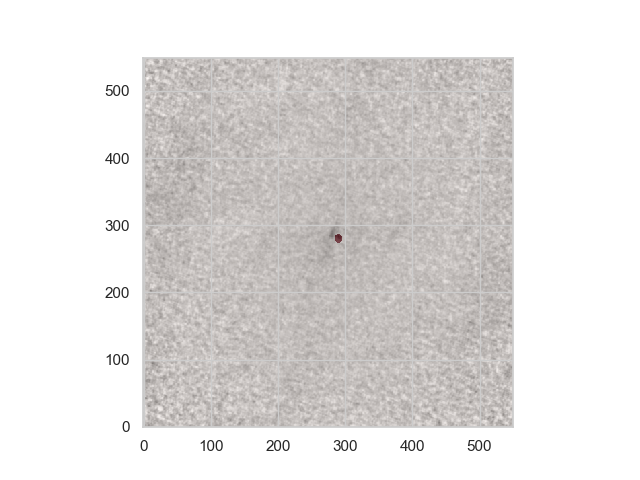

In [5]:
def beam(x0,y0,a=5.641585836808E-05/8.333E-06,b=4.732591824399E-05/8.333E-06):
    x,y = np.mgrid[0:mom0.shape[0],0:mom0.shape[1]]
    ellipse = ((x-x0)/a)**2 + ((y-y0)/b)**2 < 1
    return ellipse.astype(int)

elli = beam(280,290)
fig, ax = plt.subplots(1,1)
ax.imshow(mom0,origin='lower',cmap='Greys')
ax.imshow(elli,origin='lower',alpha=0.5,cmap='Reds')

fits.writeto('../Data/LensigStuff/AS1063/beams.fits',data=elli,header=wcs_alma.to_header(),overwrite=True)

Measure the beam in source plane

<IPython.core.display.Javascript object>


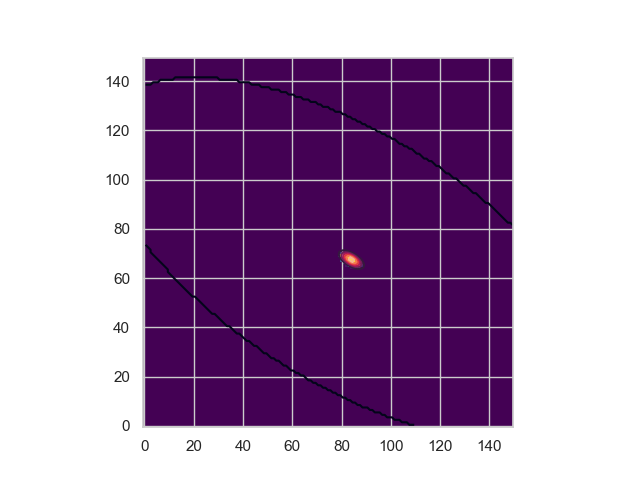

Beam size: 0.98 x 0.43 kpc


In [6]:
beam_source_plane = fits.getdata('../Data/LensigStuff/AS1063/SP_beams.fits')
header_source_plane = fits.getheader('../Data/LensigStuff/AS1063/SP_beams.fits')

# Plot
plt.figure()
plt.imshow(beam_source_plane,origin='lower',vmin=0,vmax=1,cmap='viridis')

# Fit
y, x = np.mgrid[:beam_source_plane.shape[0], :beam_source_plane.shape[1]]

# Fit complete image beam
p_init = models.Gaussian2D(x_mean=83,y_mean=67)
fit_p = fitting.LevMarLSQFitter()
p = fit_p(p_init, x, y, beam_source_plane)
plt.contour(p(x, y), origin='lower')
print('Beam size: %0.2f x %0.2f kpc'%(p.x_stddev.value*header_source_plane['CDELT2']*3600/cosmo.arcsec_per_kpc_comoving(0.611).value, p.y_stddev.value*header_source_plane['CDELT2']*3600/cosmo.arcsec_per_kpc_comoving(0.611).value)) 

### Define empty and HST regions 

And measure noise level

RMS in Box1: 0.00027961
RMS in Box2: 0.00027363
Mean RMS: 0.00027662


<IPython.core.display.Javascript object>


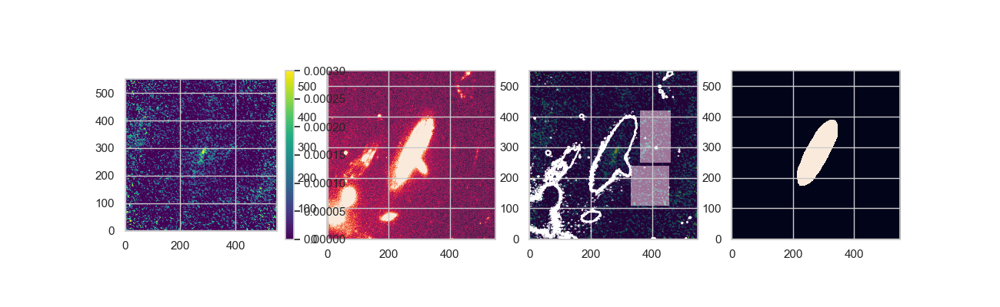

Pixels in HST region: 14843
Pixels in empty region 1: 17000
Pixels in empty region 2: 16250


In [6]:
# Load HST image and make mask
hst_smooth = filters.gaussian_filter(hst_im, sigma=10)
rms_hst = np.sqrt(np.nanmean((hst_im - np.nanmean(hst_im))**2))
mask = hst_smooth > 0.5*rms_hst
mask[:,:170]  = 0 
mask[:100,:]  = 0 
x,y = np.meshgrid(range(mask.shape[0]),range(mask.shape[1]))
mask[np.where((y < 1.7*x - 265))] = 0

# Define empty regions
box1 = np.zeros_like(hst_im)
box1[110:240,330:455] = 1
box1[250:420,360:460] = 1

mask1 = np.zeros_like(hst_im)
mask2 = np.zeros_like(hst_im)
mask2[110:240,330:455] = 1
mask1[250:420,360:460] = 1

rms1 = np.sqrt(np.mean(crop_data[:,110:240,330:455]**2))
rms2 = np.sqrt(np.mean(crop_data[:,250:420,360:460]**2))
rms = np.mean((rms1,rms2))
print('RMS in Box1: %0.8f'%rms1)
print('RMS in Box2: %0.8f'%rms2)
print('Mean RMS: %0.8f'%rms)

fig, ax = plt.subplots(1,4,figsize=(13,4.))
cax = ax[0].imshow(alma_im,vmin=0,vmax=0.0003,origin='lower',cmap='viridis')
cbar = fig.colorbar(cax,fraction=0.05,ax=ax[0])

ax[1].imshow(hst_im,origin='lower',vmax=0.01)

ax[2].imshow(alma_im,vmin=0,vmax=0.0003,origin='lower',cmap='viridis')
ax[2].contour(hst_im,levels=[0.005],colors='w',linewidth=0.8)
ax[2].imshow(box1,origin='lower',alpha=0.5)

ax[3].imshow(mask,origin='lower')

print('Pixels in HST region: %d'%len(np.where(mask==1)[1]))
print('Pixels in empty region 1: %d'%len(np.where(mask1==1)[1]))
print('Pixels in empty region 2: %d'%len(np.where(mask2==1)[1]))

Save target region as fits

In [ ]:
fits.writeto('as1063_target_mask.fits',data=np.array(mask).astype(int),header=wcs_alma.to_header())

## Define functions that will go in the astrodendro prunning

In [7]:
from astrodendro.pruning import all_true

def is_inside_box1(structure, index=None, value=None):
    peak_index, peak_value = structure.get_peak()
    return mask1[peak_index[1],peak_index[2]]

def is_inside_box2(structure, index=None, value=None):
    peak_index, peak_value = structure.get_peak()
    return mask2[peak_index[1],peak_index[2]]

def is_inside_box(structure, index=None, value=None):
    peak_index, peak_value = structure.get_peak()
    return np.any((mask1[peak_index[1],peak_index[2]],mask2[peak_index[1],peak_index[2]]))

def is_inside_hst(structure, index=None, value=None):
    peak_index, peak_value = structure.get_peak()
    return mask[peak_index[1],peak_index[2]]

def min_beam_size(structure, index=None, value=None):
    """ Loop in the channels to make sure at least one has more than 18 pixels (spatial direction)."""
    c, x, y = structure.indices()
    test = False
    for channel in set(c):
        pix = np.where(c==channel)
        if len(x[pix]) > 17. :
            test = True
    return test

And some other auxiliary functions for plotting

In [8]:
def plot_to_compare(d,p,title,im=alma_im):

    # 3D selection
    fig,ax = plt.subplots(1, 2, figsize=(12,5))
    fig.suptitle(title)
    ax[0].imshow(im, origin='lower', interpolation='nearest',cmap=plt.cm.Blues, vmax=2*rms,vmin=0)

    leaves = []
    for nb,leaf in enumerate(d.leaves):
        leaves.append(leaf.idx)
        p.plot_contour(ax[0], structure=leaf, lw=3, colors='orange')
        s = PPVStatistic(leaf)
        ellipse = s.to_mpl_ellipse(edgecolor='m', facecolor='none',lw=1.5)
        ax[0].add_patch(ellipse)
        ax[0].annotate('%d (%d)'%(nb,leaf.idx),xy=ellipse.center,color='m')     

    # Draw beam
    beam = Ellipse(xy=(235,100), width=6.8, height=5.7, angle=7.287213897705E+01,facecolor='k')
    ax[0].add_artist(beam)

    p.plot_tree(ax[1], color='black')
    ax[1].set_xlabel("Structure")
    ax[1].set_ylabel("Flux")

### Establish the fiducual thresholds

Keep delta=1 and find the calue of min_value for which there are no detections in the empty region.

<IPython.core.display.Javascript object>


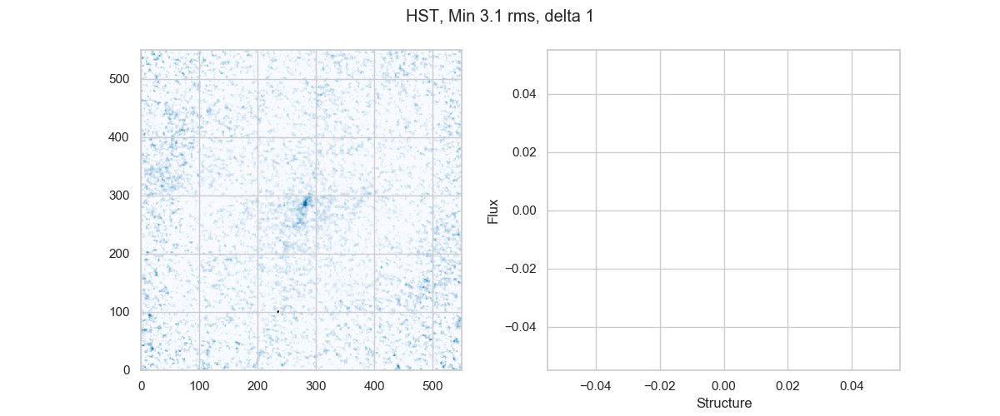

<IPython.core.display.Javascript object>


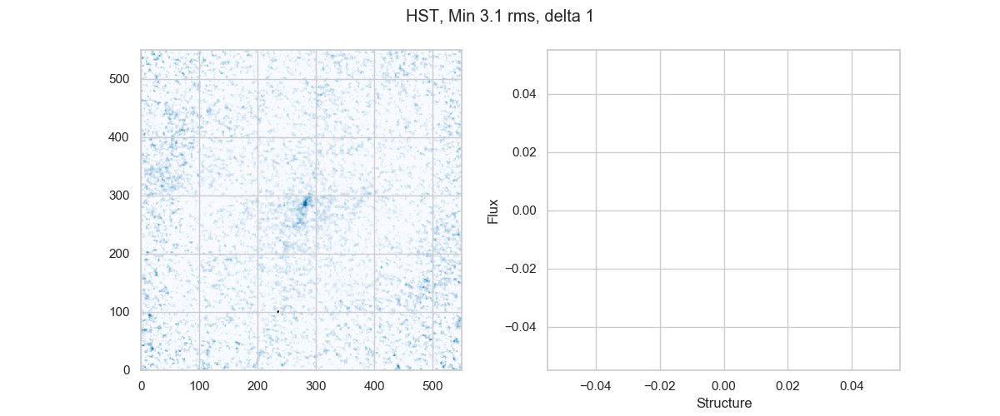

<IPython.core.display.Javascript object>


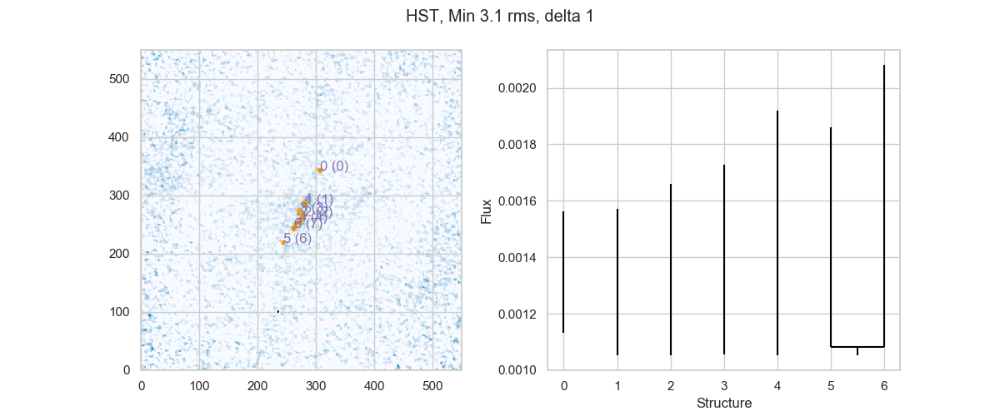

In [9]:
rms_fiducial = 3.8

d_M3D1_B1 = Dendrogram.compute(crop_data,min_value=rms_fiducial*rms,min_delta=1*rms,min_npix=0,
                               is_independent=all_true((is_inside_box1,min_beam_size)))

p_M3D1_B1 = d_M3D1_B1.plotter()
plot_to_compare(d_M3D1_B1,p_M3D1_B1,'HST, Min 3.1 rms, delta 1',im=alma_im)

d_M3D1_B2 = Dendrogram.compute(crop_data,min_value=rms_fiducial*rms,min_delta=1*rms,min_npix=0,
                               is_independent=all_true((is_inside_box2,min_beam_size)))

p_M3D1_B2 = d_M3D1_B2.plotter()
plot_to_compare(d_M3D1_B2,p_M3D1_B2,'HST, Min 3.1 rms, delta 1',im=alma_im)

d_M3D1_C = Dendrogram.compute(crop_data,min_value=rms_fiducial*rms,min_delta=1*rms,min_npix=0,
                              is_independent=all_true((is_inside_hst,min_beam_size)))
p_M3D1_C = d_M3D1_C.plotter()
plot_to_compare(d_M3D1_C,p_M3D1_C,'HST, Min 3.1 rms, delta 1',im=alma_im)

### Make a catalogue

In [10]:
metadata = {}
metadata['data_unit'] = u.Jy 

cat_M3D1_C = ppv_catalog(d_M3D1_C.leaves, metadata, verbose=False)
cat_M3D1_C.show_in_notebook()

idx,_idx,area_ellipse,area_exact,flux,major_sigma,minor_sigma,position_angle,radius,v_cen,v_rms,x_cen,y_cen
,,pix2,pix2,Jy,pix,pix,deg,pix,pix,pix,pix,pix
0,0,11.81742456907601,36.0,0.05320563493296504,1.9683190620717685,1.3785718459826186,176.31140835924685,1.6472611337863388,3.8532613134015703,0.3538452266935328,307.28754473933697,342.5797943213386
1,1,40.24361940819998,145.0,0.41282025387044996,3.9628427607542087,2.3318051488272267,52.80939828518813,3.039831764015793,9.312475398899462,2.0291050728889783,281.06581350587845,285.51200984060296
2,2,14.947027495231643,43.0,0.05908323510084301,2.273287850159284,1.5097410612676414,89.66378013131792,1.8525863033786882,11.0,0.0,279.1326788870118,263.45153503905874
3,3,36.811787134482636,81.0,0.12403758126311004,3.7252312229697826,2.269006458490211,63.88390829415955,2.9073310276416455,13.02848320538739,0.7923216864640881,272.08409496270446,270.634554670941
4,4,36.096040799245465,92.0,0.17408527969382703,4.204836650983721,1.9711174566432463,-136.1135053023253,2.8789280861263866,12.962874466883582,0.5211630859888713,271.40576413278166,254.63461159975583
5,6,6.408930412307305,20.0,0.026348398067057133,1.5441072532562916,0.9530378683742897,79.01199759256868,1.2130921997872444,14.0,0.0,243.66423157398808,218.57928499291498
6,7,16.131221048865836,54.0,0.08434491883963346,2.2547053456650836,1.642780398686986,58.625018748892565,1.9245741728167727,14.095954624610942,0.2945290047291022,262.51758107690057,243.61650866280996


## Decide on the best values for Fmin and Delta

In [11]:
from normalize import APLpyNormalize

def make_rgb_image(im_r,im_g,im_b,min_p=(3.,3.,3.),mid_p=(70.,70.,70.),max_p=(99.5,99.5,99.5),stretch='arcsinh',plot=False):
    '''
    Takes 3 images and makes an rgb image.
    From David Carton.
    Parameters:
    -----------
    im_r: array
        red image
    im_g: array
        green image
    im_b: array
        blue image
    min_p: float
        percentile to calculate vmin of the image
    mid_p: float
        vmid
    max_p: float
        vmax
    Returns
    -----
    image (array)
    ''' 

    valid = np.isfinite(im_r)
    valid &= np.isfinite(im_g)
    valid &= np.isfinite(im_b)

    im_r[~valid] = 0.
    im_g[~valid] = 0.
    im_b[~valid] = 0.

    vmin, vmid, vmax = np.percentile(im_r, [min_p[0], mid_p[0], max_p[0]])
    norm = APLpyNormalize(stretch=stretch, vmin=vmin, vmax=vmax,
                      vmid=vmid)
    im_r = norm(im_r, clip=True)

    vmin, vmid, vmax = np.percentile(im_g, [min_p[1], mid_p[1], max_p[1]])
    norm = APLpyNormalize(stretch=stretch, vmin=vmin, vmax=vmax,
                      vmid=vmid)
    im_g = norm(im_g, clip=True)

    vmin, vmid, vmax = np.percentile(im_b, [min_p[2], mid_p[2], max_p[2]])
    norm = APLpyNormalize(stretch=stretch, vmin=vmin, vmax=vmax,
                      vmid=vmid)
    im_b = norm(im_b, clip=True)

    image = np.array([im_r, im_g, im_b])
    image = np.rollaxis(image, 0, 3)

    if plot:
        ratio = float(image.shape[0]) / float(image.shape[1])
        fig = plt.figure(figsize=(10.,10*ratio), frameon=False)
        ax = fig.add_axes([0,0,1,1])
        ax.set_axis_off()
        ax.imshow(image, interpolation='nearest', origin='lower')
    
    return image

rgb_as1063 = make_rgb_image(HST_red,HST_green,HST_blue,(5,5,5),(10,10,10),(99.95,99.96,99.96))[400:950,400:950]

In [12]:
def to_ds9_reg(ellipses,wcs,outfile):
    
    f = open(outfile,'w')
    f.write('# Region file format: DS9 version 4.1\n')
    f.write('global color=red dashlist=8 3 width=1 font="helvetica 10 normal roman" select=1 highlite=1 dash=0 fixed=0 edit=1 move=1 delete=1 include=1 source=1\n')
    f.write('fk5\n')
    
    for e in ellipses:
        centre = wcs.all_pix2world(e.center[0],e.center[1],0)
        h,w = e.height*abs(wcs_alma.wcs.cdelt[0])*3600, e.width*abs(wcs_alma.wcs.cdelt[0])*3600 # in arcsec
        f.write('ellipse(%0.12f,%0.12f,%0.4f",%0.4f",%d)\n'%(centre[0],centre[1],h,w,e.angle+90))
    
    f.close()

In [13]:
def plot_alma(d,p,name):
    
    x = ax[1]
    cmap = sns.cubehelix_palette(start=0, light=1, as_cmap=True)
    x.imshow(mom0, origin='lower', vmax=0.2,vmin=-0.01)

    ellip_list = []
    for nb,leaf in enumerate(d.leaves):
        p.plot_contour(x, structure=leaf, linewidths=1, colors='#5ca904')
        s = PPVStatistic(leaf)
        ellipse = s.to_mpl_ellipse(edgecolor='w', facecolor='0.8',lw=1,alpha=0.65)
        ellip_list.append(ellipse)
        x.add_patch(ellipse)
    to_ds9_reg(ellip_list,wcs_alma,name)

    x.add_artist(Ellipse(xy=(350,180), width=6.8, height=5.7, angle=7.287213897705E+01,facecolor='w'))
    x.hlines(y=375,xmin=200,xmax=200+(1/(8.3333333333333E-06 *3600)),color='w')
    x.annotate('1"',xy=(200, 380), color='w',fontsize=10)

    x.axis('off')
    x.set_xlim(185,365)
    x.set_ylim(160,400)
    
def plot_hst(d,p):
    
    x = ax[2]
    x.imshow(rgb_as1063, origin='lower')

    for nb,leaf in enumerate(d.leaves):
        p.plot_contour(x, structure=leaf, linewidths=1, colors='#5ca904')
        
    x.axis('off')
    x.set_xlim(185,365)
    x.set_ylim(160,400)

def plot_muse(d,p):
    
    x = ax[3]
    cax = x.contour(oii_vel-40,levels=np.arange(-200,200,20),cmap="RdBu_r",linewidths=0.8,inline=1)
    cmap = plt.cm.RdBu_r
    cmap.set_bad('#516572',0.4)
    cax = x.imshow(mom1,origin='lower',cmap="RdBu_r",vmin=-200,vmax=200)
    plt.colorbar(cax,ax=x,fraction=0.04)

    for nb,leaf in enumerate(d.leaves):
        p.plot_contour(x, structure=leaf, linewidths=1, colors='#5ca904')

    x.axis('off')
    x.set_xlim(185,365)
    x.set_ylim(160,400)


def is_same_clump(cat1,cat2,radius=3):
    match = []
    for c in cat1:
        x,y,v = c['x_cen'],c['y_cen'],c['v_cen']
        for t in cat2:
            if np.sqrt((t['x_cen']- x)**2 + (t['y_cen']- y)**2 + (t['v_cen']- v)**2) < radius:
                match.append(c.index)
    return match

def is_in_tree(dend,cat):
    match = []
    for c in dend.leaves:
        if c.idx != c.ancestor.idx:
            match.append(c.idx)
    indices = [np.int(np.where(cat['_idx'] == m)[0]) for m in match]
    return indices

def plot_scatter(d_C,d_B1,d_B2):
    
    x = ax[0]
    sns.scatterplot([-1,-1],[-1,-1],marker='',ax=x)

    try:
        cat_B1 = ppv_catalog(d_B1.leaves, metadata,verbose=False)
        sns.scatterplot(cat_B1['flux'],cat_B1['radius'],marker='s',alpha=0.8, color=sns.xkcd_rgb['cornflower'],s=70,
                   label='Empty region 1',ax=x)
        nb_B1 = len(cat_B1)
    except AttributeError:
        nb_B1 = np.nan
        print('No detections in Box 1') 
        
    try:
        cat_B2 = ppv_catalog(d_B2.leaves, metadata,verbose=False)
        sns.scatterplot(cat_B2['flux'],cat_B2['radius'],marker='s',alpha=0.8, color=sns.xkcd_rgb['olive green'],s=70,
                   label='Empty region 2',ax=x)
        nb_B2 = len(cat_B2)
    except AttributeError:
        nb_B2 = np.nan
        print('No detections in Box 2')
    
    cat_C = ppv_catalog(d_C.leaves, metadata,verbose=False)
    nb_C = len(cat_C)
    sns.scatterplot(cat_C['flux'],cat_C['radius'],marker='o',color=sns.xkcd_rgb['dark pink'],alpha=0.8,s=70,label='Target region',ax=x)

    x.set_xlabel('Flux (Jy)')
    x.set_ylabel('Radius (pix)')
    #x.set_xlim(0,0.1)
    #x.set_ylim(0,0.225)
    
    print('Number of clumps %d'%nb_C)

    return (nb_C,np.nansum((nb_B1,nb_B2)))

Systematic plots of number of clumps found in target and empty areas

Make tables with number of clumps per region with each combination of parameters

<IPython.core.display.Javascript object>


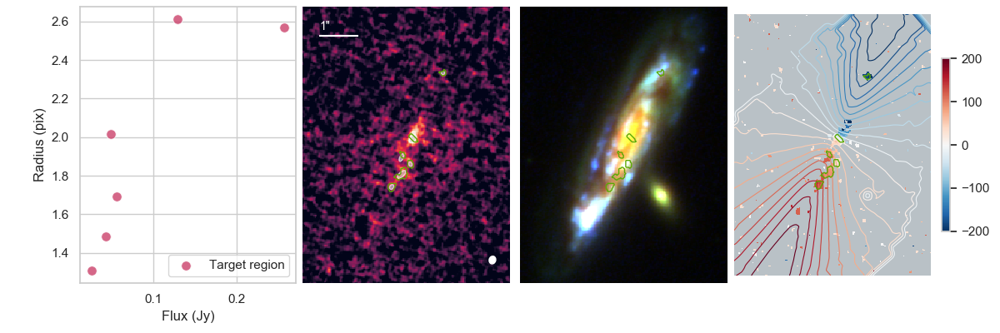

No detections in Box 1
No detections in Box 2
Number of clumps 6


<IPython.core.display.Javascript object>


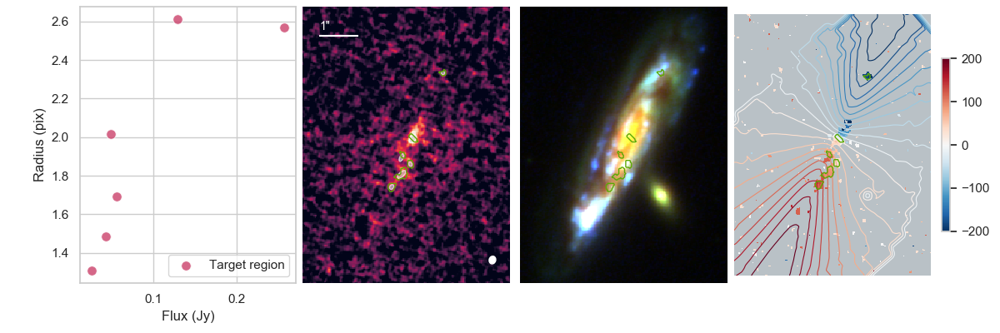

No detections in Box 1
No detections in Box 2
Number of clumps 6


<IPython.core.display.Javascript object>


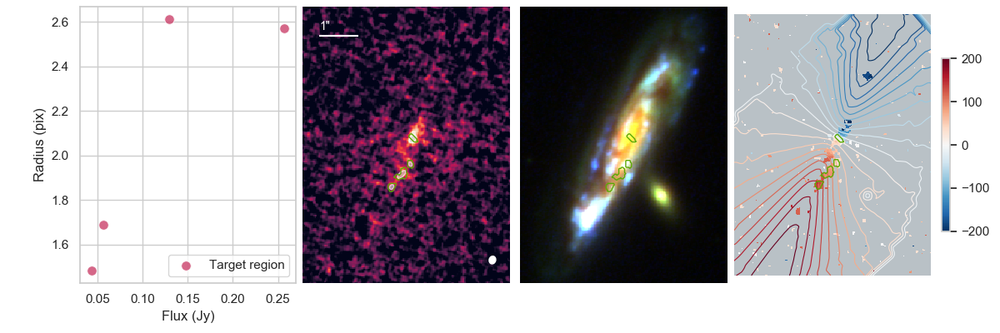

No detections in Box 1
No detections in Box 2
Number of clumps 4


<IPython.core.display.Javascript object>


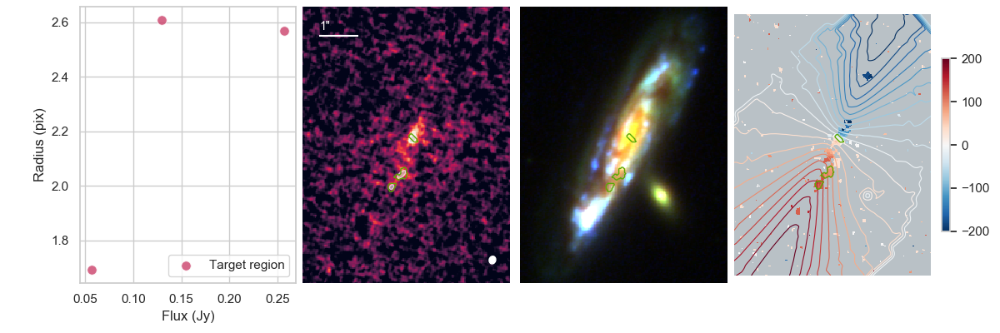

No detections in Box 1
No detections in Box 2
Number of clumps 3


<IPython.core.display.Javascript object>


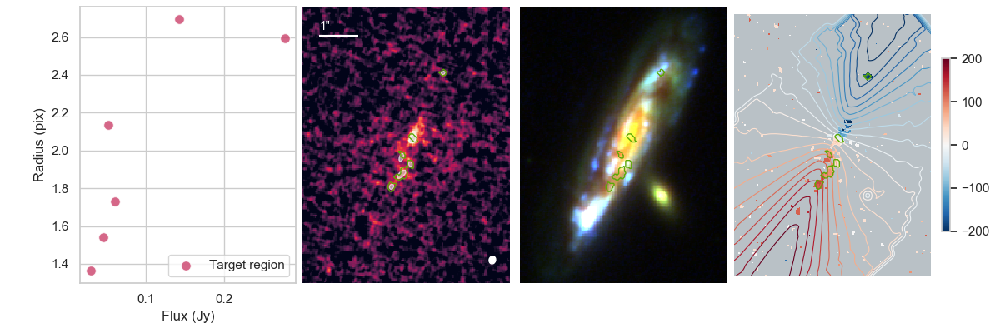

No detections in Box 1
No detections in Box 2
Number of clumps 6


<IPython.core.display.Javascript object>


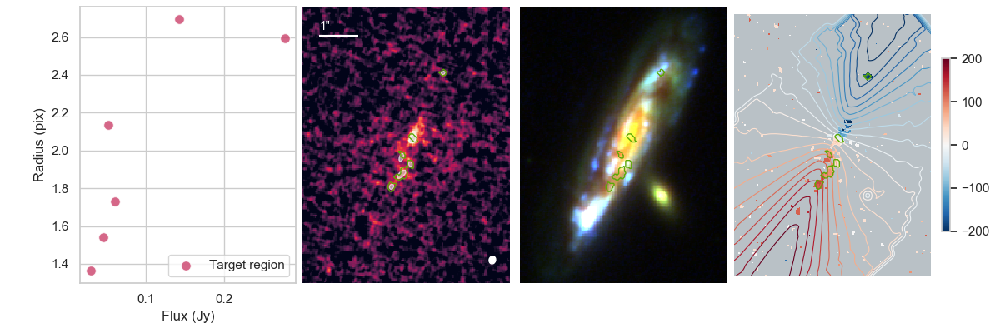

No detections in Box 1
No detections in Box 2
Number of clumps 6


<IPython.core.display.Javascript object>


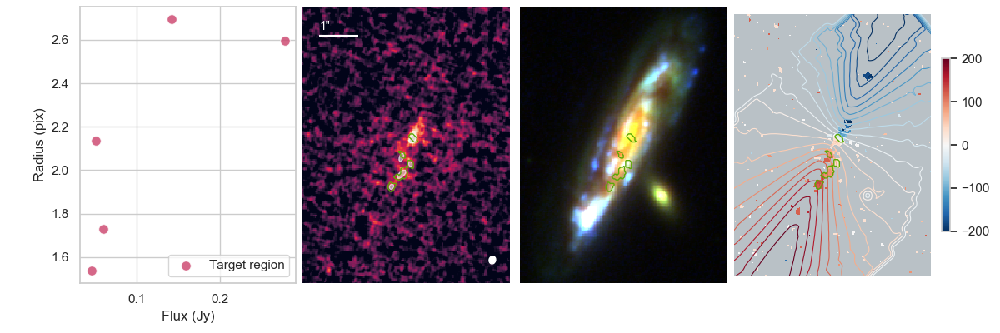

No detections in Box 1
No detections in Box 2
Number of clumps 5


<IPython.core.display.Javascript object>


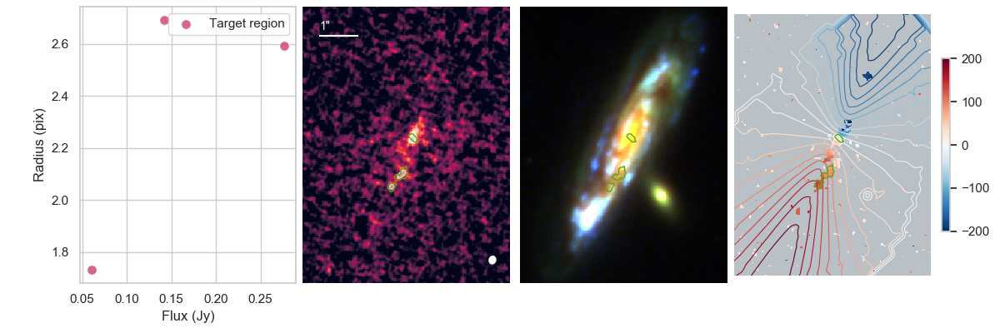

No detections in Box 1
No detections in Box 2
Number of clumps 3


<IPython.core.display.Javascript object>


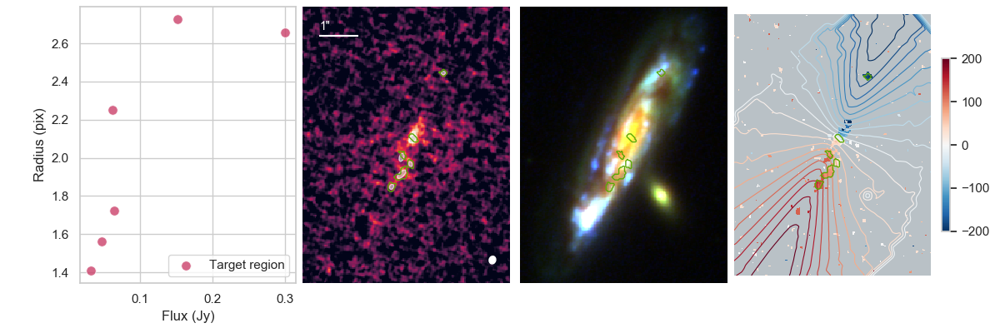

No detections in Box 1
No detections in Box 2
Number of clumps 6


<IPython.core.display.Javascript object>


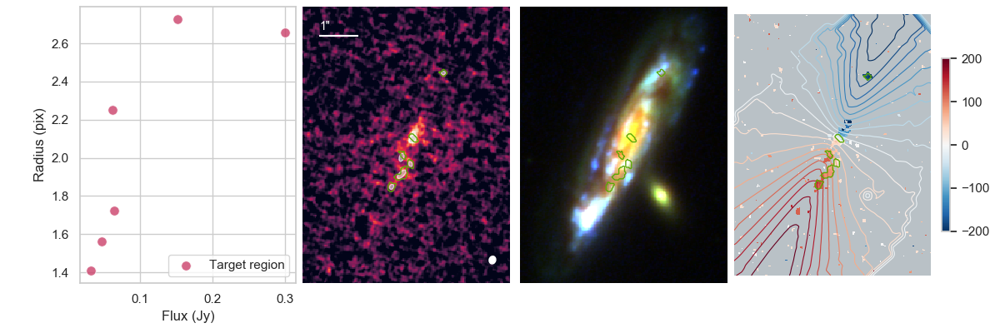

No detections in Box 1
No detections in Box 2
Number of clumps 6


<IPython.core.display.Javascript object>


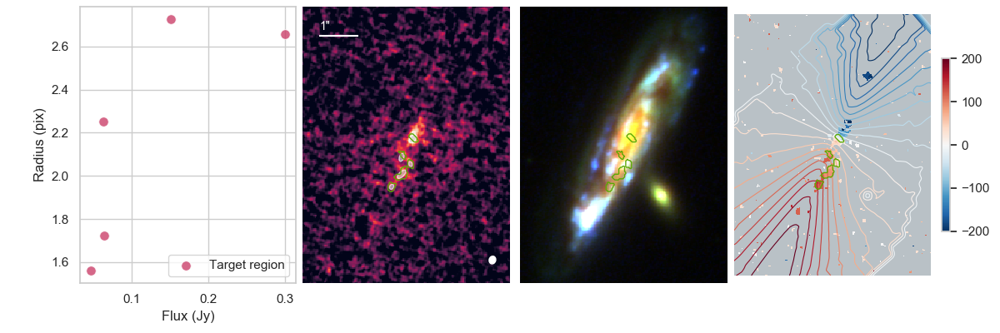

No detections in Box 1
No detections in Box 2
Number of clumps 5


<IPython.core.display.Javascript object>


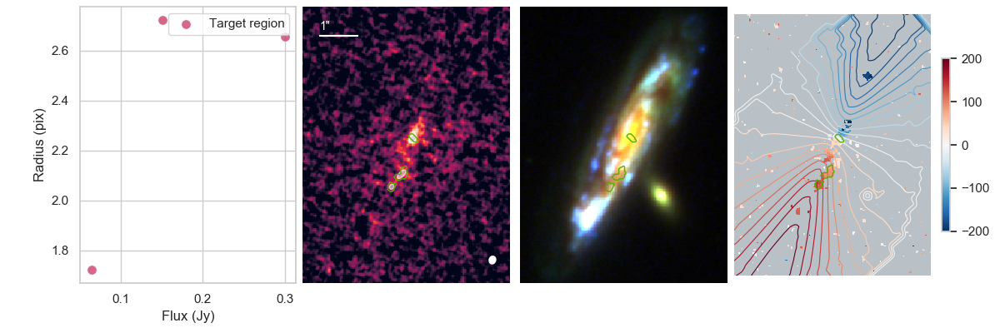

No detections in Box 1
No detections in Box 2
Number of clumps 3


<IPython.core.display.Javascript object>


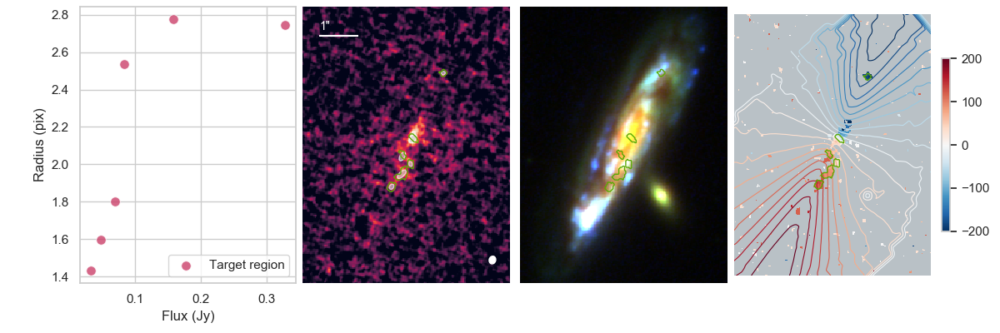

No detections in Box 1
No detections in Box 2
Number of clumps 6


<IPython.core.display.Javascript object>


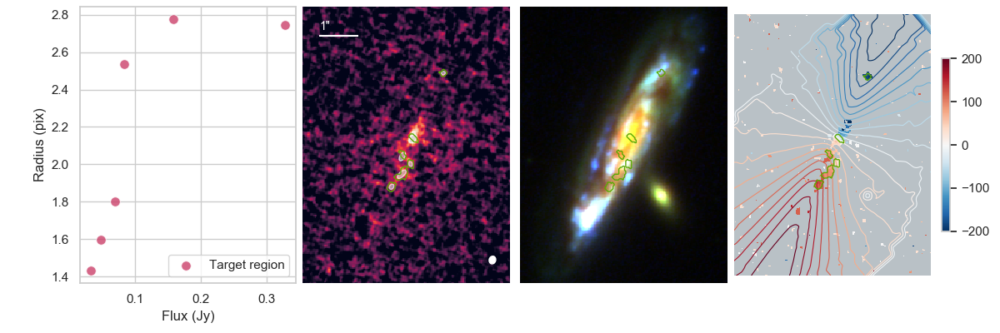

No detections in Box 1
No detections in Box 2
Number of clumps 6


<IPython.core.display.Javascript object>


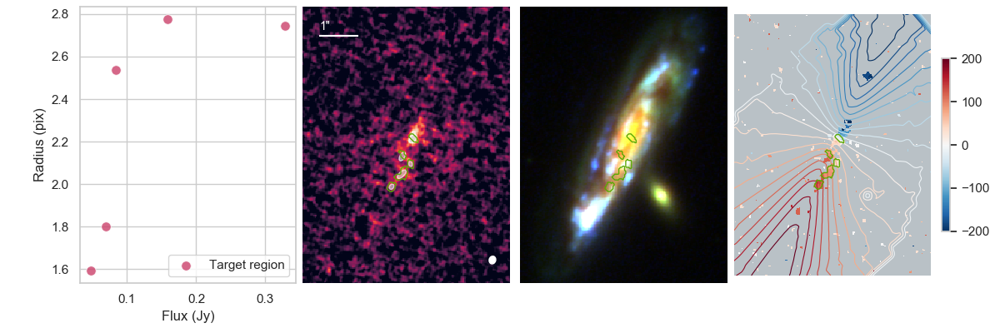

No detections in Box 1
No detections in Box 2
Number of clumps 5


<IPython.core.display.Javascript object>


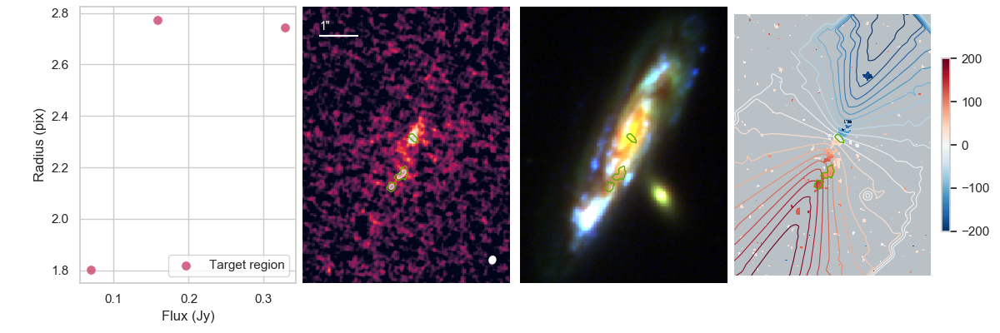

No detections in Box 1
No detections in Box 2
Number of clumps 3


<IPython.core.display.Javascript object>


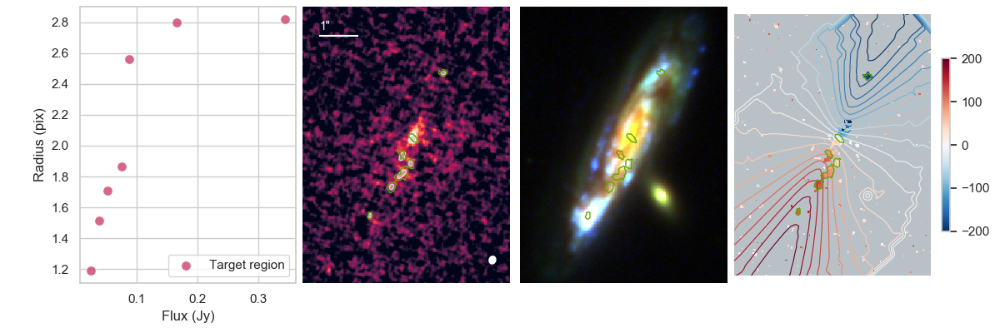

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


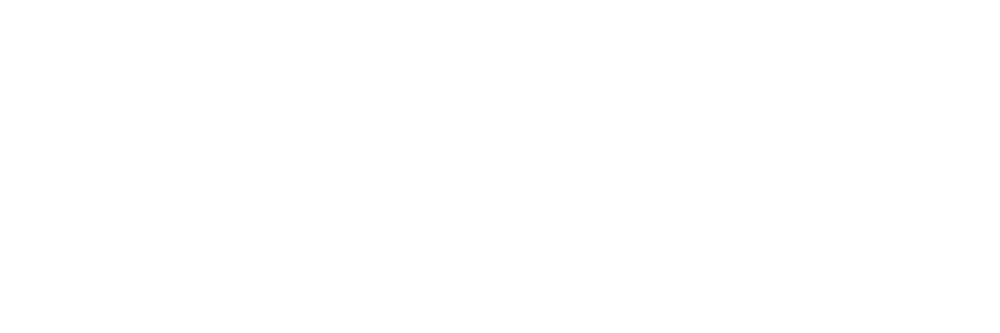

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


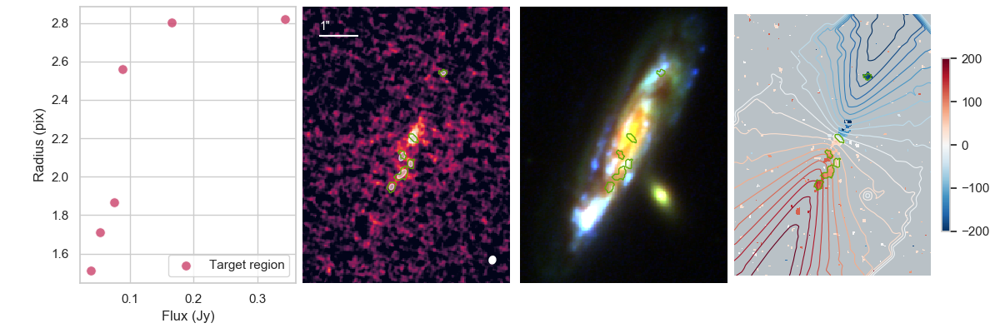

No detections in Box 1
No detections in Box 2
Number of clumps 6


<IPython.core.display.Javascript object>


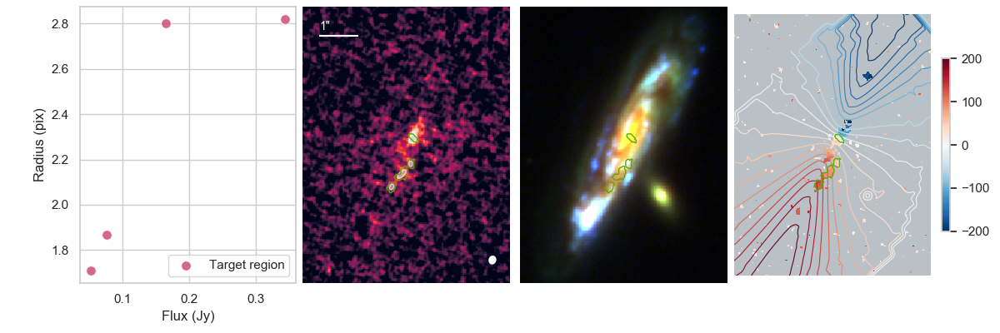

No detections in Box 1
No detections in Box 2
Number of clumps 4


<IPython.core.display.Javascript object>


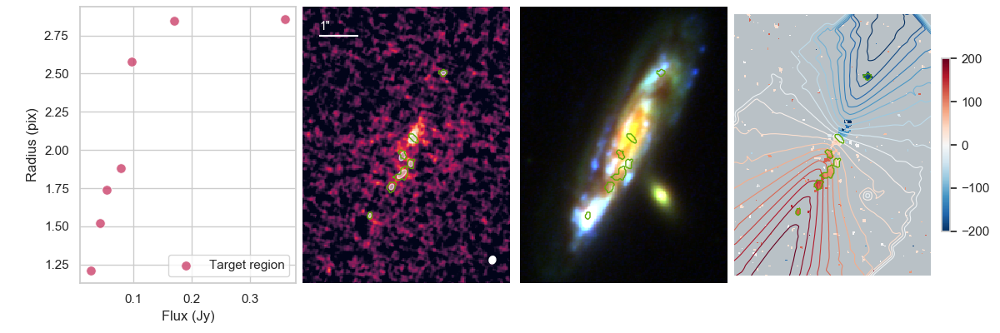

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


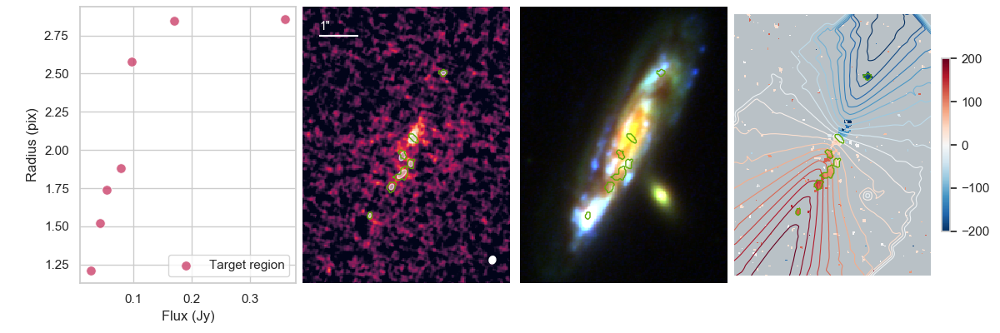

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


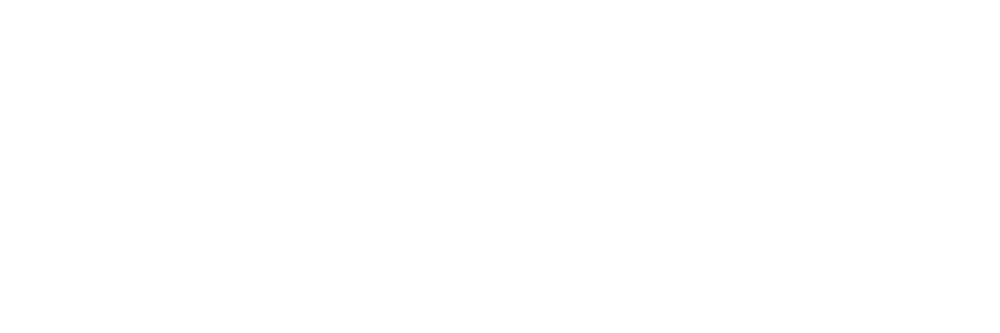

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


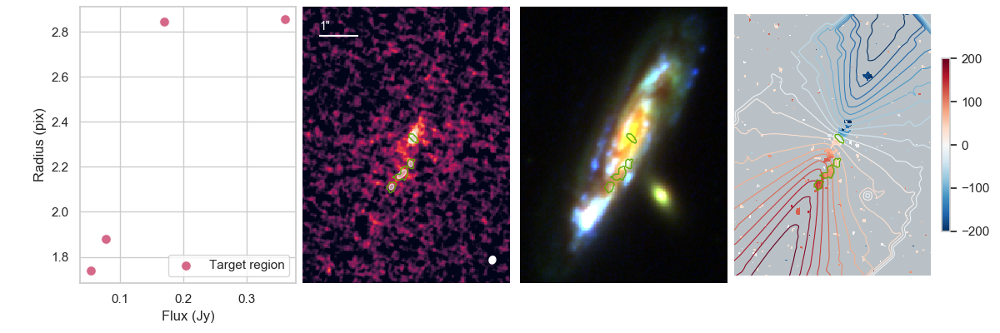

No detections in Box 1
No detections in Box 2
Number of clumps 4


<IPython.core.display.Javascript object>


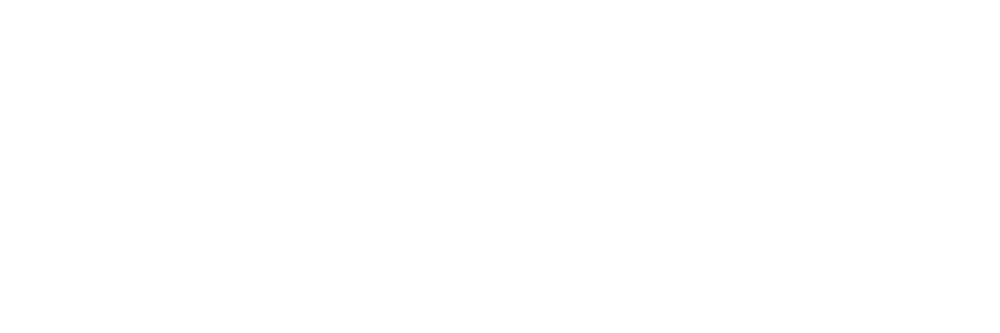

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


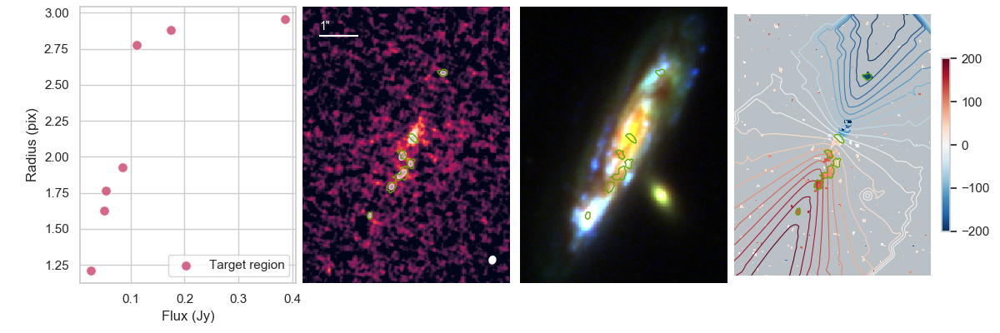

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


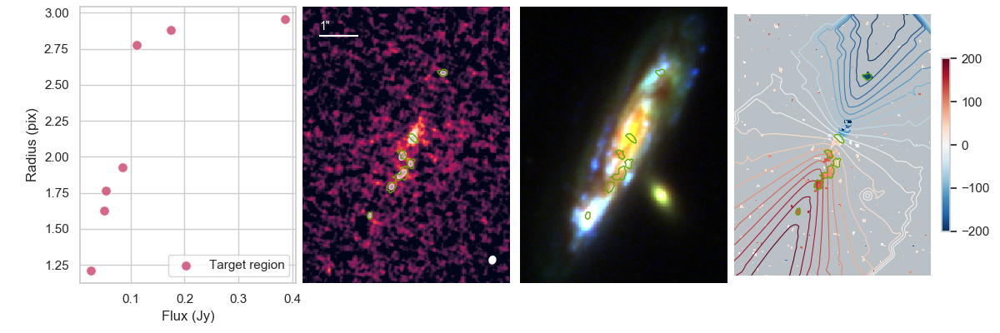

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


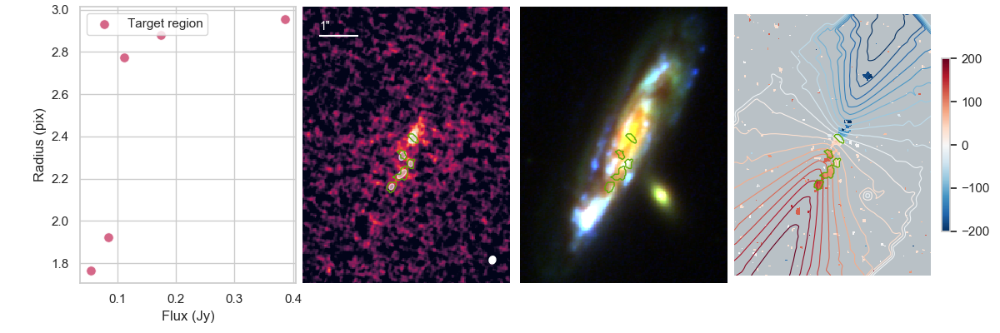

No detections in Box 1
No detections in Box 2
Number of clumps 5


<IPython.core.display.Javascript object>


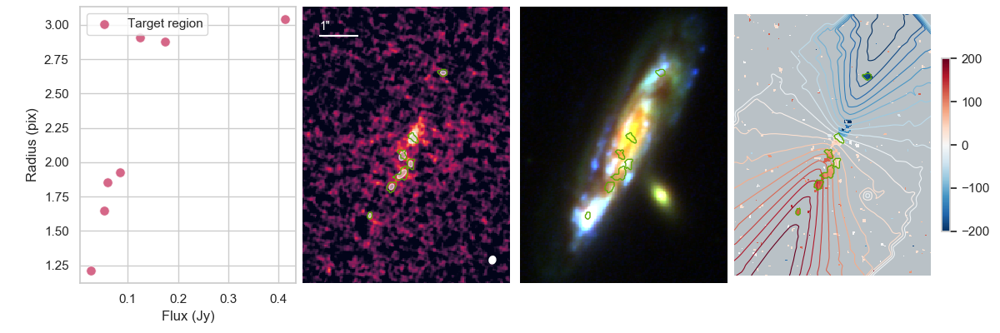

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


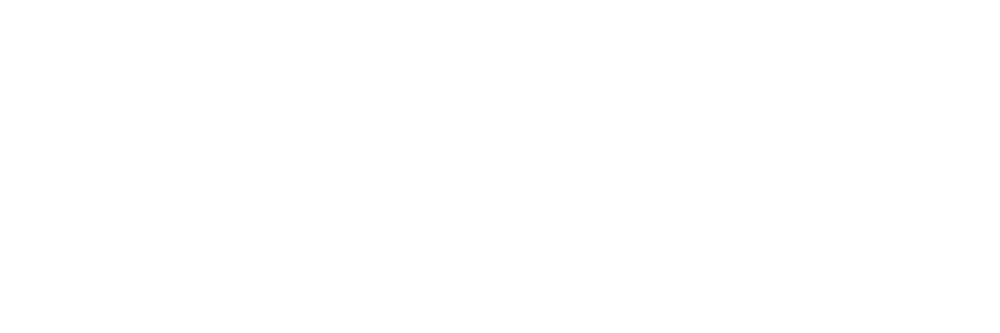

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


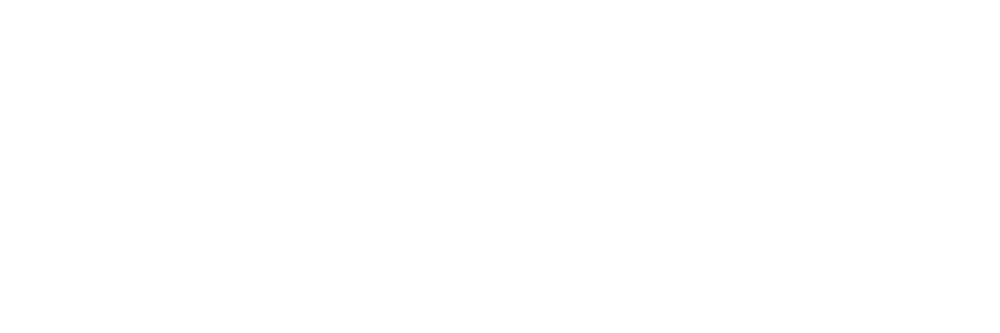

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


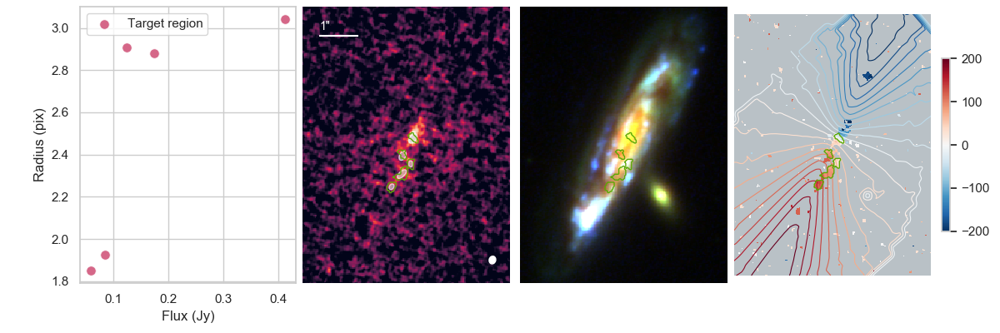

No detections in Box 1
No detections in Box 2
Number of clumps 5


<IPython.core.display.Javascript object>


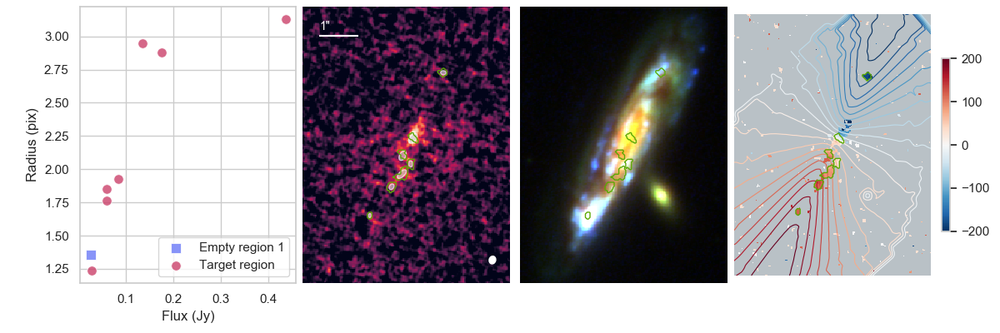

No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


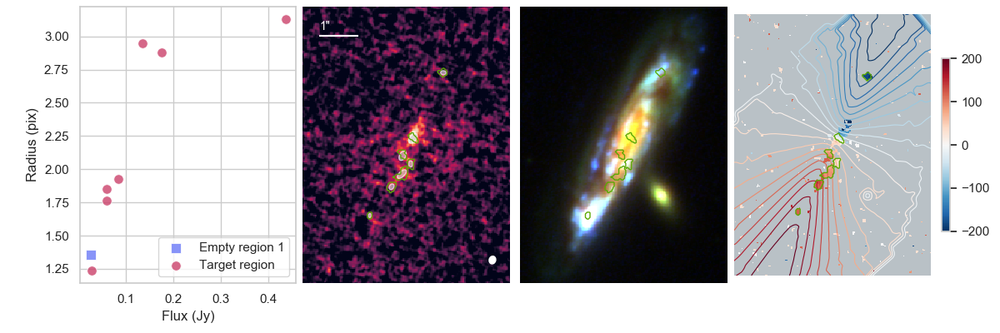

No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


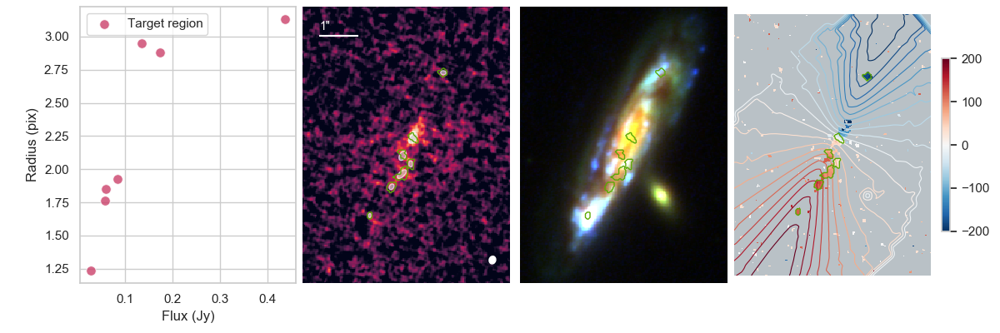

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


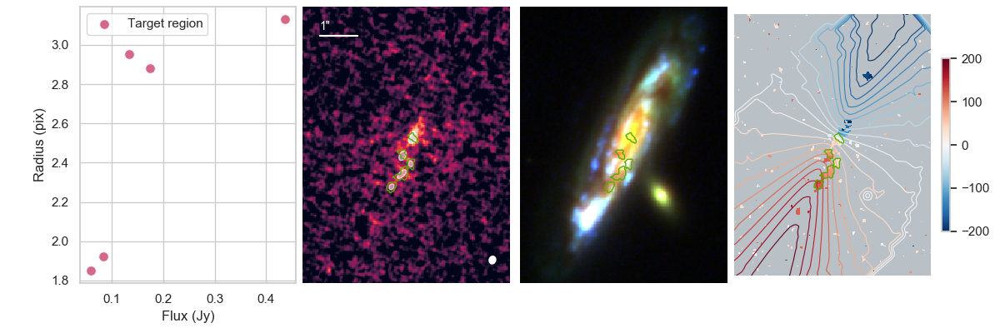

No detections in Box 1
No detections in Box 2
Number of clumps 5


<IPython.core.display.Javascript object>


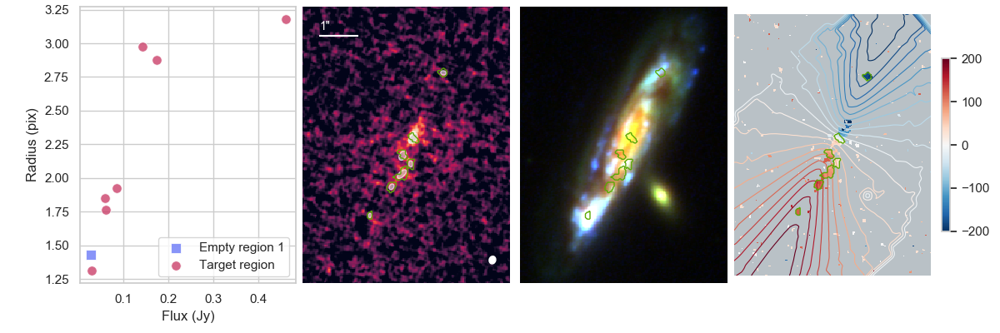

No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


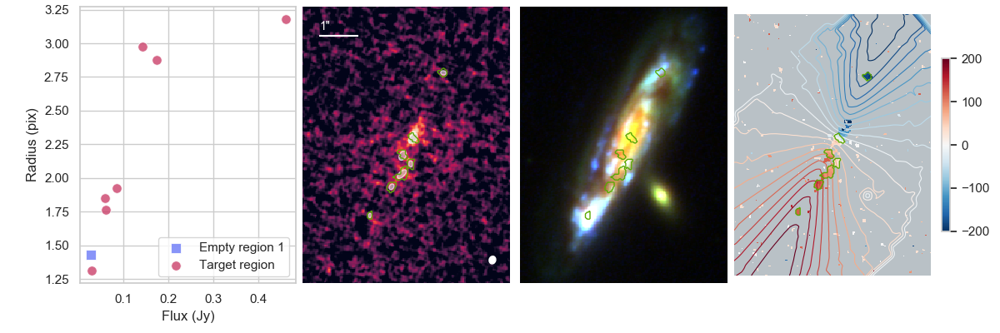

No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


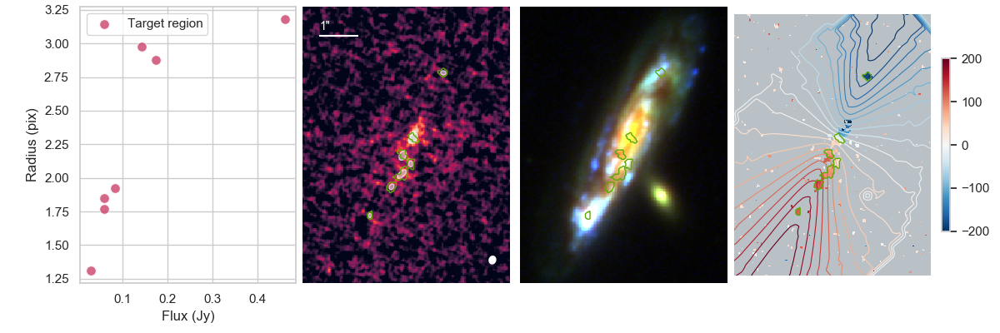

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


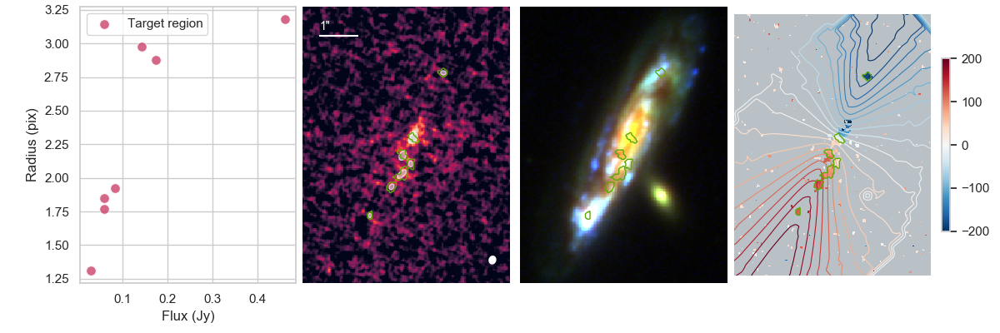

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


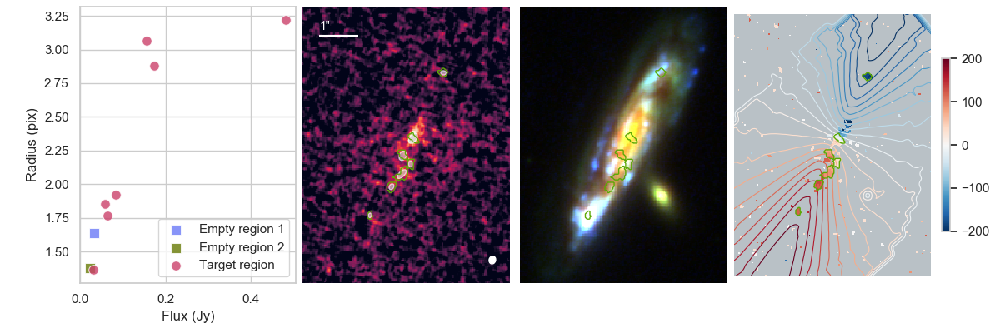

Number of clumps 7


<IPython.core.display.Javascript object>


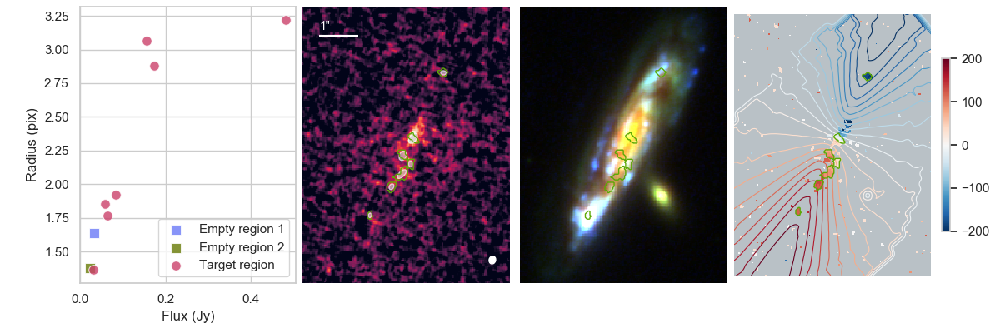

Number of clumps 7


<IPython.core.display.Javascript object>


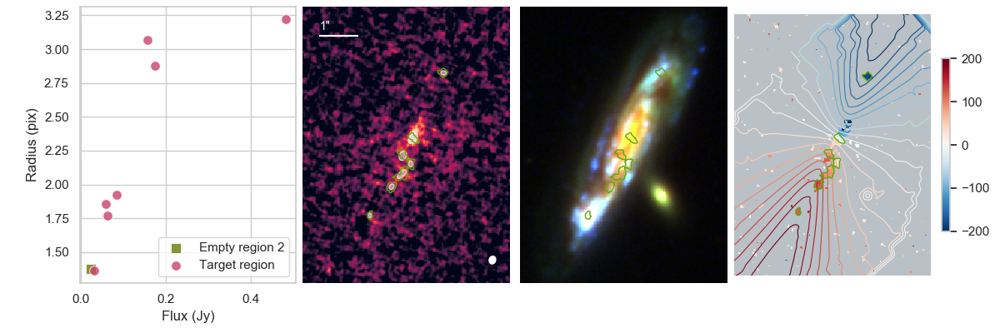

No detections in Box 1
Number of clumps 7


<IPython.core.display.Javascript object>


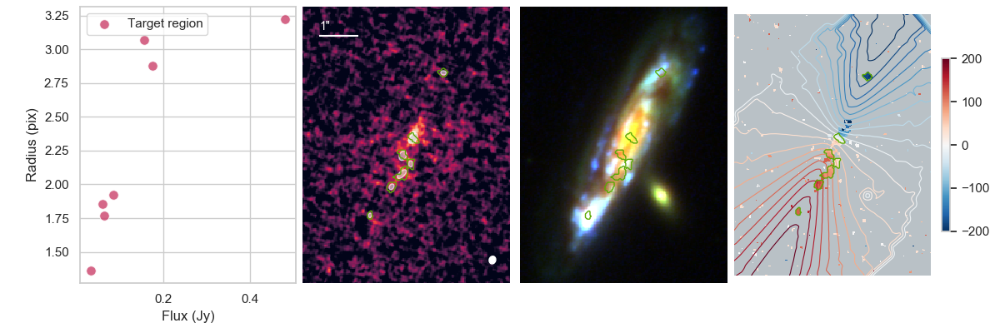

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


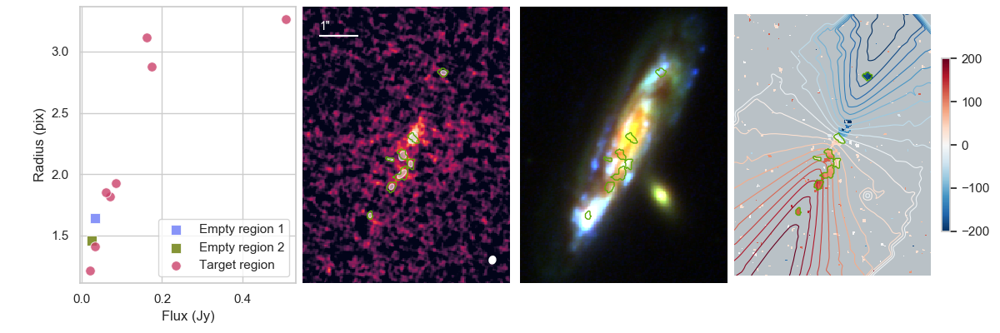

Number of clumps 8


<IPython.core.display.Javascript object>


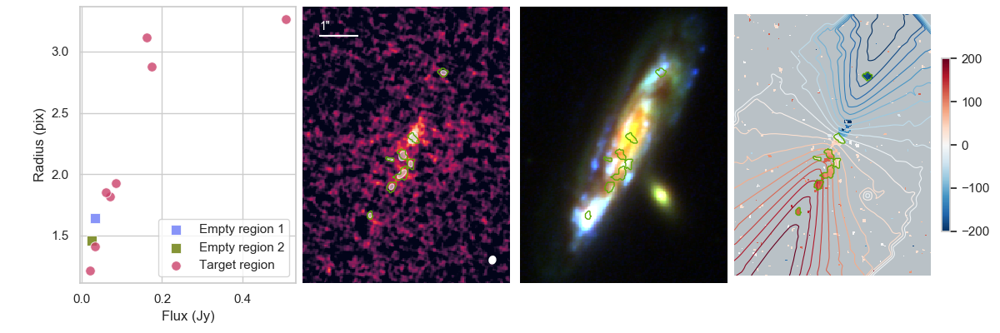

Number of clumps 8


<IPython.core.display.Javascript object>


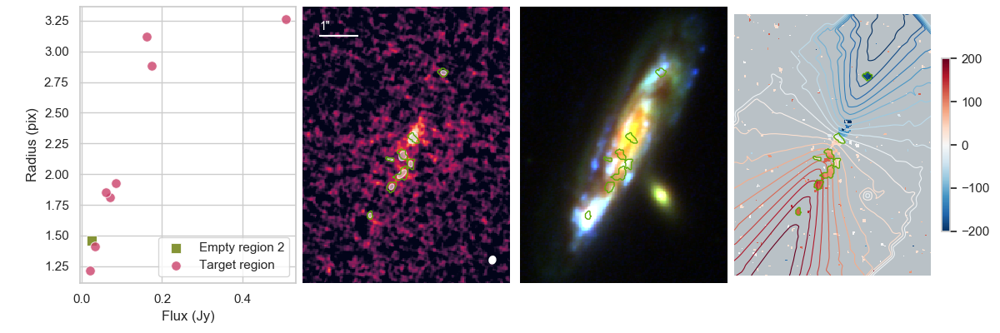

No detections in Box 1
Number of clumps 8


<IPython.core.display.Javascript object>


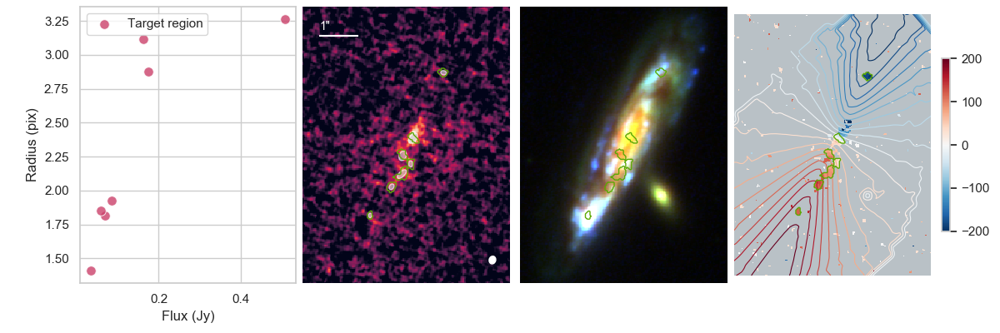

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


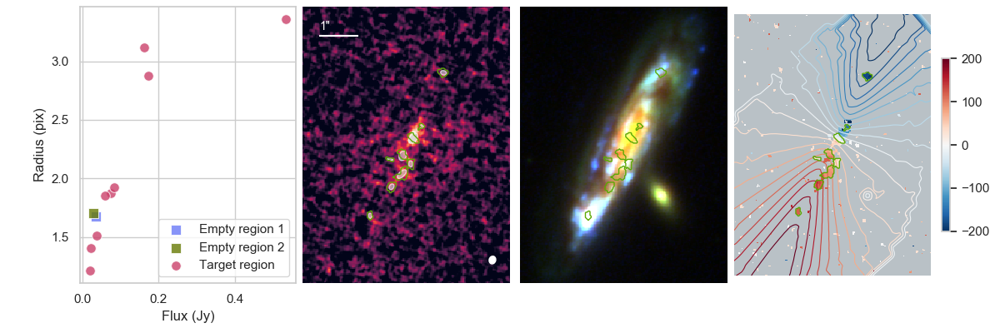

Number of clumps 9


<IPython.core.display.Javascript object>


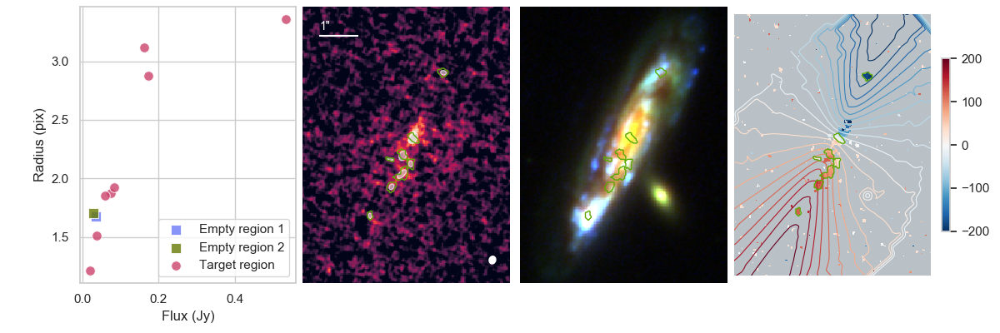

Number of clumps 8


<IPython.core.display.Javascript object>


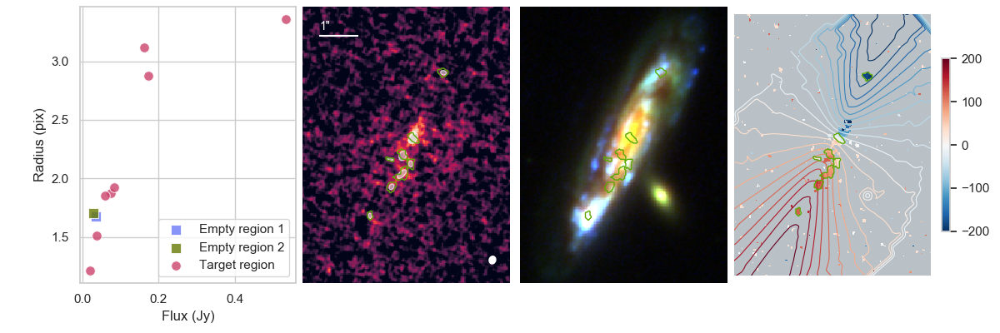

Number of clumps 8


<IPython.core.display.Javascript object>


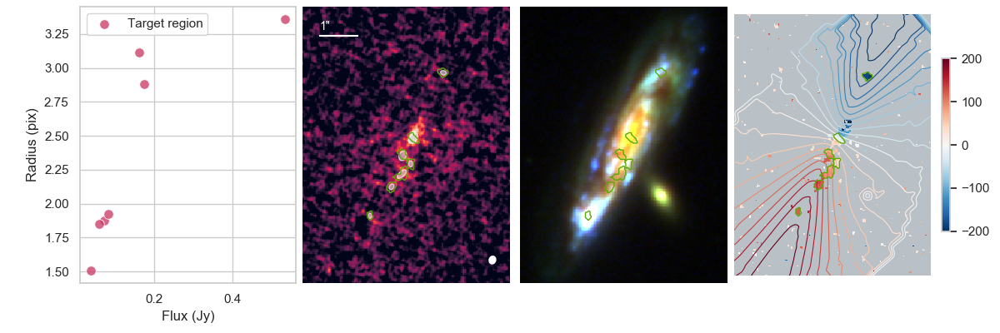

No detections in Box 1
No detections in Box 2
Number of clumps 7


<IPython.core.display.Javascript object>


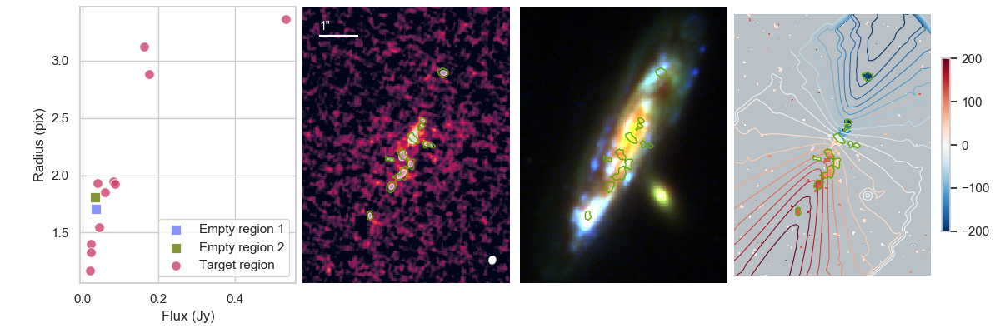

Number of clumps 11


<IPython.core.display.Javascript object>


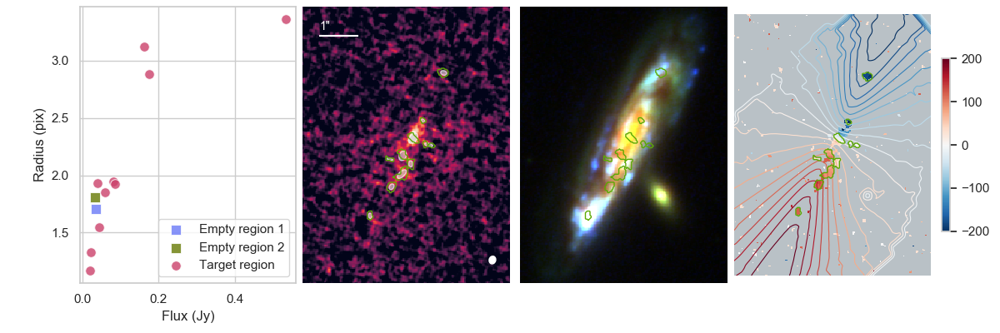

Number of clumps 10


<IPython.core.display.Javascript object>


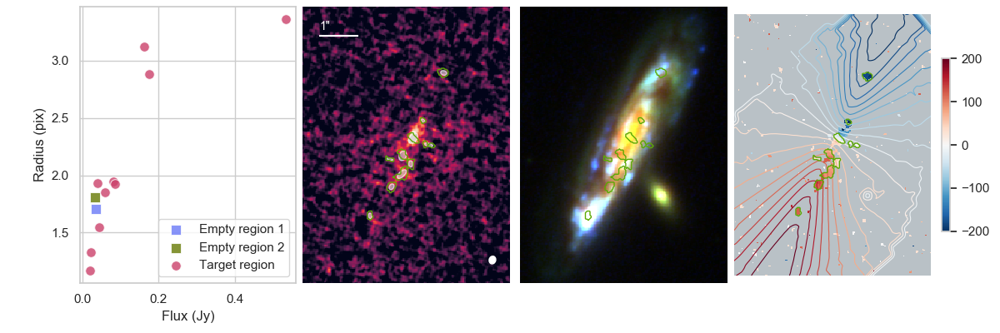

Number of clumps 10


<IPython.core.display.Javascript object>


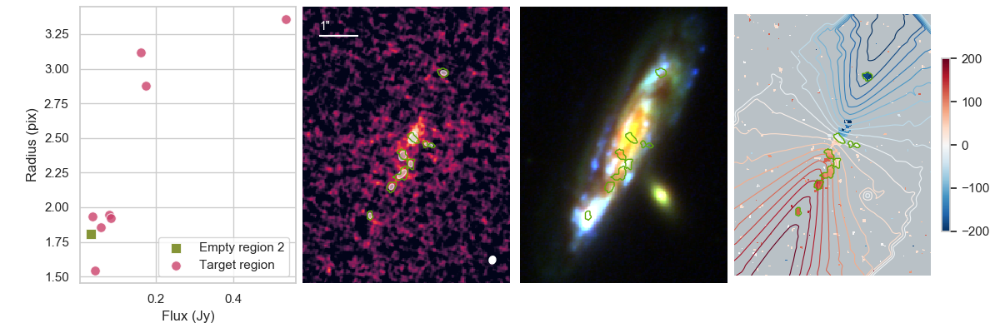

No detections in Box 1
Number of clumps 8


<IPython.core.display.Javascript object>


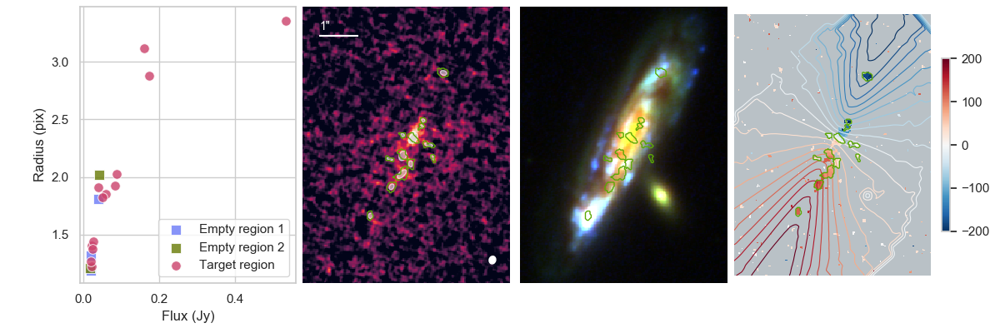

Number of clumps 13


<IPython.core.display.Javascript object>


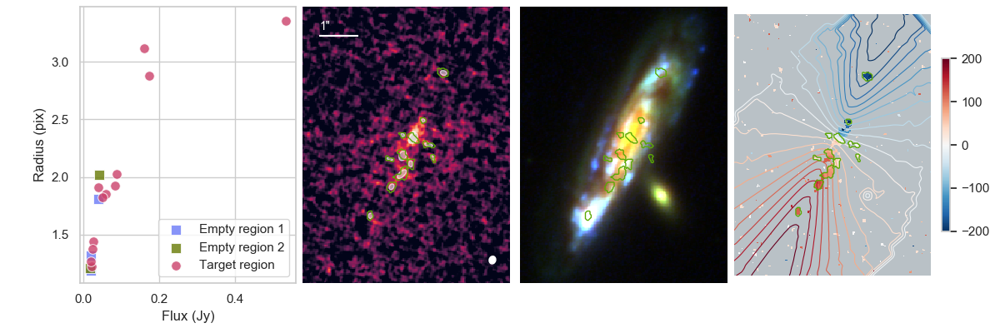

Number of clumps 12


<IPython.core.display.Javascript object>


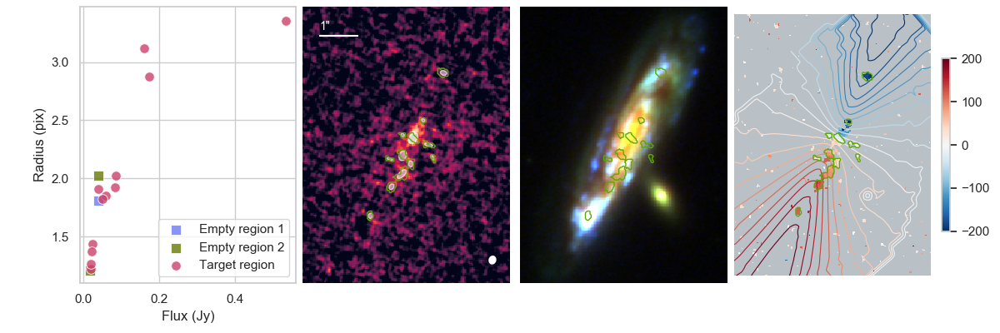

Number of clumps 12


<IPython.core.display.Javascript object>


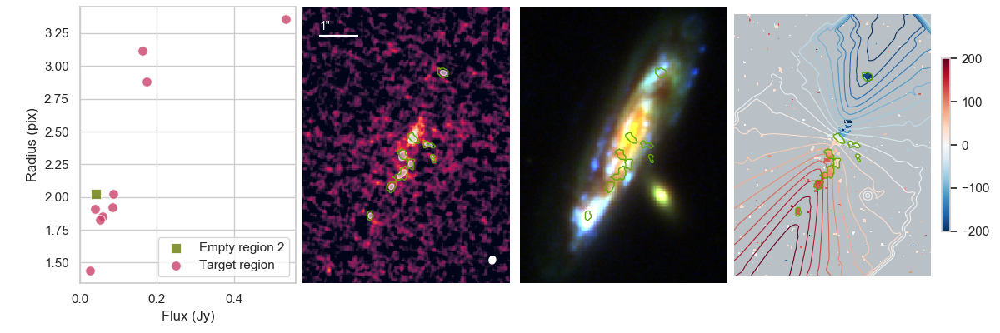

No detections in Box 1
Number of clumps 9


<IPython.core.display.Javascript object>


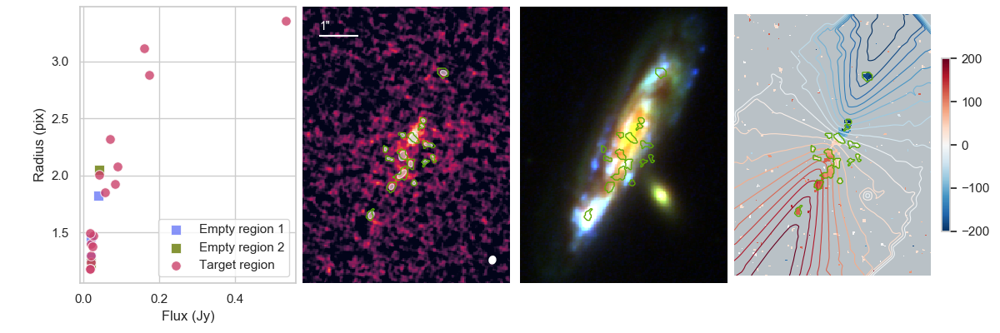

Number of clumps 16


<IPython.core.display.Javascript object>


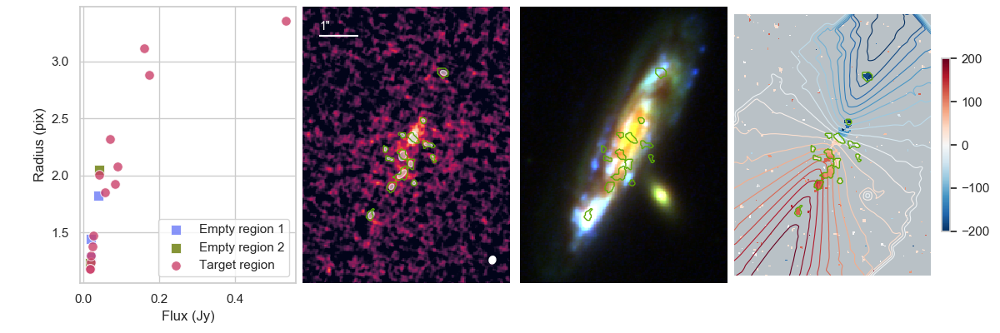

Number of clumps 14


<IPython.core.display.Javascript object>


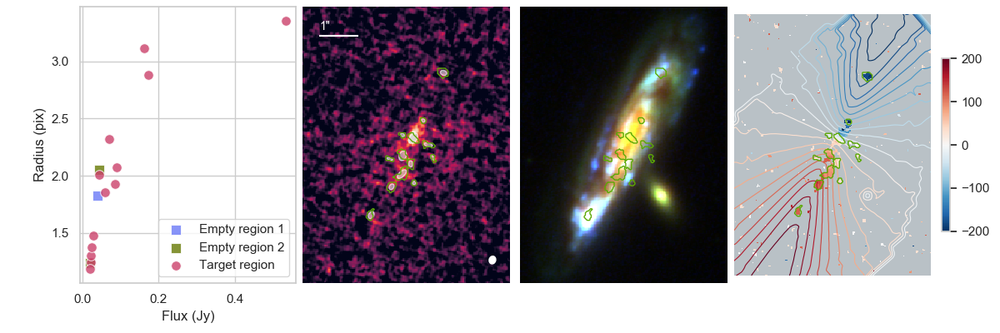

Number of clumps 13


<IPython.core.display.Javascript object>


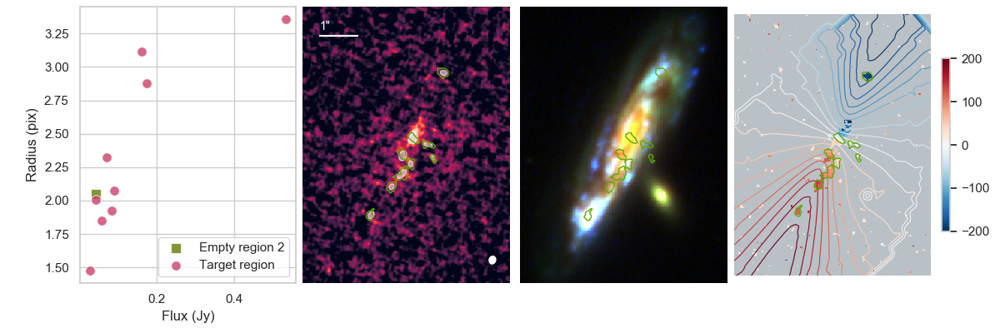

No detections in Box 1
Number of clumps 9


In [19]:
sns.set_style('whitegrid')

nb_fmin = []
nb_delta = []
nb_clumps = []
nb_empty = []
nb_empty_B1 = []
nb_empty_B2 = []
    
for fmin in np.arange(4.5,2.9,-0.1):

    for delta in [0.5,1.,1.5,2.0]:

        d_C = Dendrogram.compute(crop_data,min_value=fmin*rms,min_delta=delta*rms,min_npix=0,is_independent=all_true((is_inside_hst,min_beam_size)))
        p_C = d_C.plotter()
        cat_c =  ppv_catalog(d_C.leaves, metadata,verbose=False) 

        d_B2 = Dendrogram.compute(crop_data,min_value=fmin*rms,min_delta=delta*rms,min_npix=0,is_independent=all_true((is_inside_box1,min_beam_size)))

        d_B1 = Dendrogram.compute(crop_data,min_value=fmin*rms,min_delta=delta*rms,min_npix=0,is_independent=all_true((is_inside_box2,min_beam_size)))

        fig, ax = plt.subplots(1,4,figsize=(12,4))
        fig.subplots_adjust(top=0.98,bottom=0.15,left=0.08,right=0.95,wspace=0.01)
        plot_alma(d_C,p_C,'dummy')
        plot_hst(d_C,p_C)
        plot_muse(d_C,p_C)
        nb_c,nb_e = plot_scatter(d_C,d_B1,d_B2)

        nb_fmin.append(fmin)
        nb_delta.append(delta)
        nb_clumps.append(nb_c)
        nb_empty.append(nb_e)
        nb_empty_B1.append(len(d_B1.leaves))
        nb_empty_B2.append(len(d_B2.leaves))

Now changing the Delta

In [22]:
## Save table
t = Table(data = [np.round(nb_fmin,2),nb_delta,nb_clumps,nb_empty,nb_empty_B1,nb_empty_B2], names=['Fmin','Delta','NbClumps','NbFalse','NbFalse1','NbFalse2'])
t.write('as1063_fmin_delta_grid.tab',format='ascii.fixed_width_two_line')

Plot the results

<IPython.core.display.Javascript object>


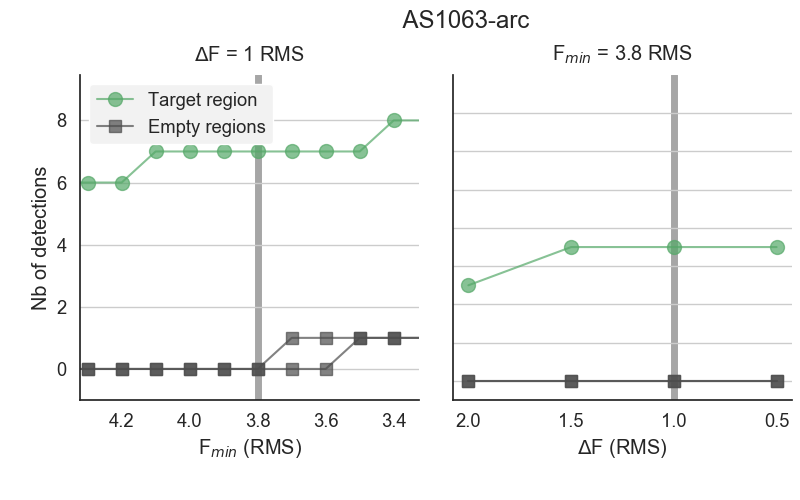

(4.7, 2.7)

In [24]:
sns.set(font_scale=1.2)
sns.set_style('white')

fig, ax = plt.subplots(1,2,figsize=(8,5))
fig.subplots_adjust(top=0.85,bottom=0.2,left=0.1,right=0.99,wspace=0.1)
fig.suptitle('                    AS1063-arc')

t = Table.read('as1063_fmin_delta_grid.tab',format='ascii.fixed_width_two_line')
t = t[t['Fmin']<4.6]

# Variation of Fmin, keeping Delta to 1
ax[0].set_title('$\Delta$F = 1 RMS',pad=10)
t_fmin = t[np.where(t['Delta']==1)]
ax[0].plot(t_fmin['Fmin'],t_fmin['NbClumps'],label='Target region',marker='o',alpha=0.7,color='C2',markersize=10)
ax[0].plot(t_fmin['Fmin'],t_fmin['NbFalse1'],label='Empty regions',marker='s',alpha=0.7,color='0.3',markersize=8,zorder=1)
ax[0].plot(t_fmin['Fmin'],t_fmin['NbFalse2'],marker='s',label='',alpha=0.7,color='0.3',markersize=8,zorder=1)

ax[0].invert_xaxis()
ax[0].set_ylabel('Nb of detections')
ax[0].set_xlabel('F$_{min}$ (RMS)')
ax[0].legend(loc=2,fancybox=True, framealpha=1,edgecolor='w',facecolor='0.95')
ax[0].set_ylim(-2,15)
ax[0].axvline(3.8,linewidth=5,color='0.5',alpha=0.7,zorder=0)

# Variation of Delta, keeping Fmin to 3.8
ax[1].set_title('F$_{min}$ = 3.8 RMS',pad=10)
t_delta = t[np.where(t['Fmin']==3.8)]
t_delta.show_in_notebook()
ax[1].plot(t_delta['Delta'],t_delta['NbClumps'],marker='o',alpha=0.7,color='C2',markersize=10)
ax[1].plot(t_delta['Delta'],t_delta['NbFalse1'],marker='s',alpha=0.7,color='0.3',markersize=8)
ax[1].plot(t_delta['Delta'],t_delta['NbFalse2'],marker='s',alpha=0.7,color='0.3',markersize=8)

ax[1].invert_xaxis()
ax[1].set_ylabel('')
ax[1].set_xlabel('$\\Delta$F (RMS)')
ax[1].axvline(1.0,linewidth=5,color='0.5',alpha=0.7,zorder=0)

# Set axes
sns.despine()

### Y axis is common ##
ax[0].set_ylim(-1,16)
ax[1].set_ylim(-1,16)
ax[0].yaxis.grid(True)
ax[1].yaxis.grid(True)
ax[0].set_yticks(range(0,16,2))
ax[1].set_yticks(range(0,16,2))
ax[1].set_yticklabels([''])

### X axis ##
ax[0].set_xlim(4.7,2.7)
#ax[0].set_xticks(np.arange(4.5,2.5,-0.5))

fig.savefig('../Plots/as1063_clump_detections.jpeg')

## Save final selection

<IPython.core.display.Javascript object>


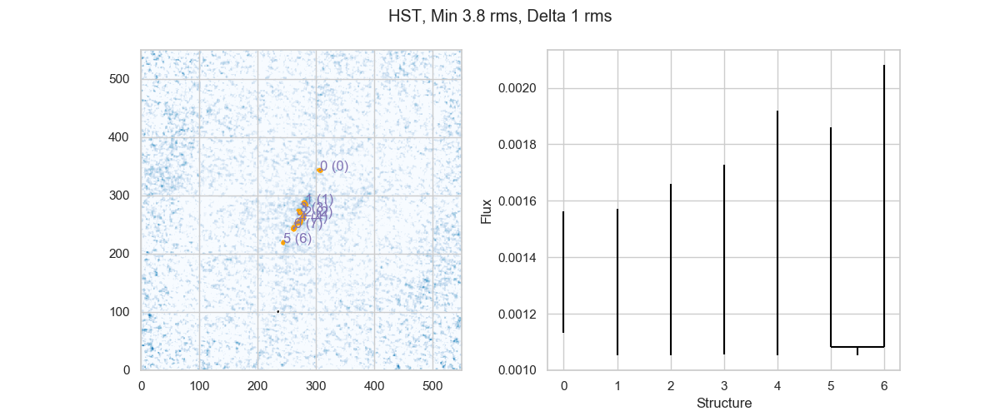

In [14]:
d_final = Dendrogram.compute(crop_data,min_value=3.8*rms,min_delta=1*rms,min_npix=0,is_independent=all_true((is_inside_hst,min_beam_size)))
p_final = d_final.plotter()
plot_to_compare(d_final,p_final,'HST, Min 3.8 rms, Delta 1 rms',im=alma_im)
cat_final = ppv_catalog(d_final.leaves, metadata=metadata,verbose=False) 

In [15]:
d_final.save_to('as1063_dendrograms_fmin38_delta1.fits')

The order of the dendrograms is not the same as the order in the catalogue.
We create some help dictionaries to deal with this

In [16]:
dendro_idx_to_hidden_idx = {}
for i in range(len(cat_final)):
    dendro_idx_to_hidden_idx[i] = d_final.leaves[i].idx

idx_to_dendro_idx = {}
for k,v in dendro_idx_to_hidden_idx.items():
    idx_to_dendro_idx[int(np.squeeze(np.where(cat_final['_idx'] == v)))] = k

## Noise selection

We choose Fmin = 2.8 RMS in order to have a comparable number of detections

<IPython.core.display.Javascript object>


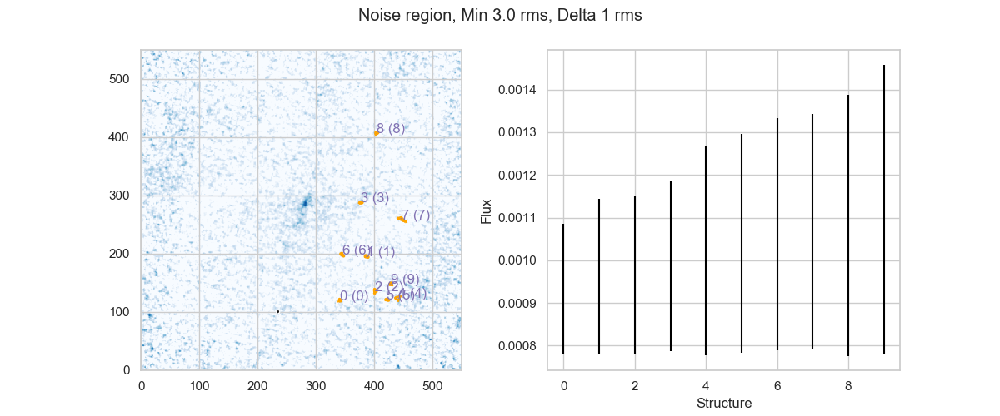

In [17]:
d_noise = Dendrogram.compute(crop_data,min_value=2.8*rms,min_delta=1*rms,min_npix=0,is_independent=all_true((is_inside_box, min_beam_size)))
p_noise = d_noise.plotter()
plot_to_compare(d_noise,p_noise,'Noise region, Min 3.0 rms, Delta 1 rms',im=alma_im)
cat_noise = ppv_catalog(d_noise.leaves, metadata=metadata,verbose=False) 

## Plot the different clumps

<IPython.core.display.Javascript object>


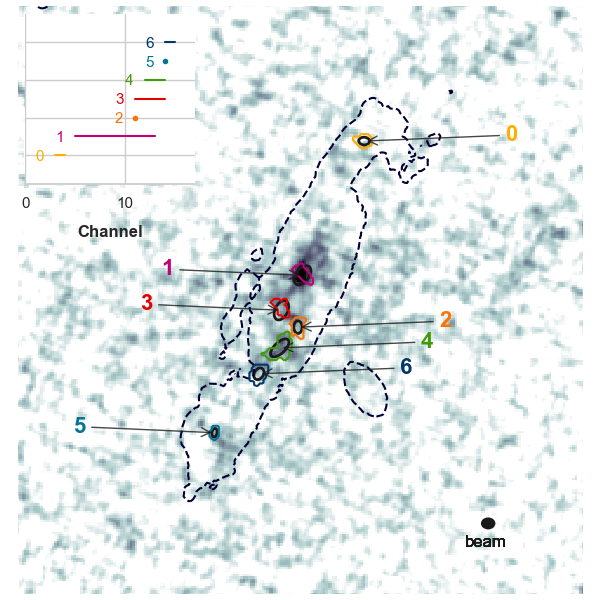

In [18]:
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

color = ['#ffad01','#c20078','#f97306','#e50000','#3f9b0b','#047495','#01386a']

fig, ax = plt.subplots(1,1,figsize=(6,6))
fig.subplots_adjust(top=0.99,bottom=0.01,left=0.01,right=0.99)
plt.imshow(alma_im,origin='lower',cmap='bone_r',vmin=0,vmax=0.00045)
plt.contour(hst_im,origin='lower',levels=[0.03],colors='#020035',linestyles='--')

i=1
for clump,c in zip(cat_final,color):

    plt.annotate(str(clump.index), 
                 xy=(clump['x_cen'], clump['y_cen']),
                 xytext=(clump['x_cen']+60*i, clump['y_cen']), 
                 arrowprops=dict(arrowstyle='->',color='0.1',alpha=0.8),
                 fontsize=16,fontweight='bold',color=c)
    
    leaf = d_final.leaves[clump.index]
    s = PPVStatistic(leaf)
    p_final.plot_contour(ax, structure=leaf, lw=3, colors=c)
    ax.add_patch(s.to_mpl_ellipse(facecolor='None',edgecolor='k',linewidth=2))

    i*=-1
    extra=0
    
    ax.add_artist(Ellipse(xy=(360,180), width=5.641585836808E-05/8.333E-06, height=4.732591824399E-05/8.333E-06, angle=0, facecolor='k',edgecolor=None))
    ax.annotate('beam',(350,170),color='k',fontsize=12)

    ax.set_xlim(160,400)
    ax.set_ylim(150,400)
    ax.axis('off')
    

# Inset
axins = inset_axes(ax, width='30%',height=1.7,loc=2,borderpad=0.5,axes_kwargs={'ylim':(-1.5,7.5),'xlim':(0,17)})
i=0
for clump,c in zip(cat_final,color):
    
        leaf = d_final.leaves[clump.index]
        vmin, vmax  = np.min(leaf.indices()[0]),np.max(leaf.indices()[0])
        if vmin==vmax:
            axins.plot(vmin,i,color=c,marker='.')
        else:
            axins.errorbar(x=[vmin,vmax],y=i,color=c)
        axins.annotate(clump.index,xy=(vmin-2,i-0.3),color=c,fontsize=11)
        i+=1
        
sns.despine(left=True)
axins.tick_params(labelleft='off')
axins.set_xlabel('Channel',fontweight='bold',labelpad=10)

fig.savefig('../Plots/as1063_clump_identification_v2.jpeg')

# Clump properties
## Uncertainties

Astrodendro does not provide uncertainties. Here we will make the Fmin vary 1 RMS (-/+0.5 of the Fiducial value) and see what happens to the clumps we've identified.

When Fmin > Fmin_fiducial, some clumps will desapear, and we will not have error bars, and others will become smaller. The values we get are lower limits

When Fmin < Fmin_fiducial, we will have more clumps and our selected clumps with be bigger.

See also [Rosolowsky&Leroy 2006](https://arxiv.org/pdf/astro-ph/0601706.pdf) for bootstrapping.

**Fmin = Fmin_fiducial+0.5 RMS**

<IPython.core.display.Javascript object>


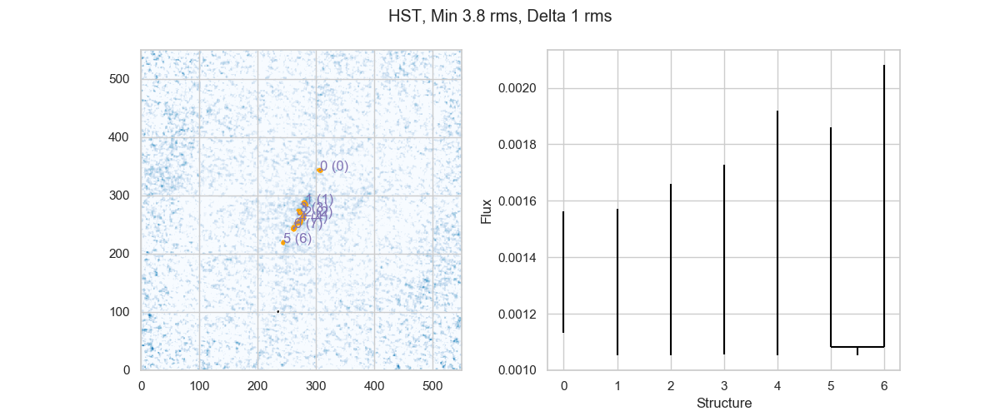

In [19]:
plot_to_compare(d_final,p_final,'HST, Min 3.8 rms, Delta 1 rms',im=alma_im)

<IPython.core.display.Javascript object>


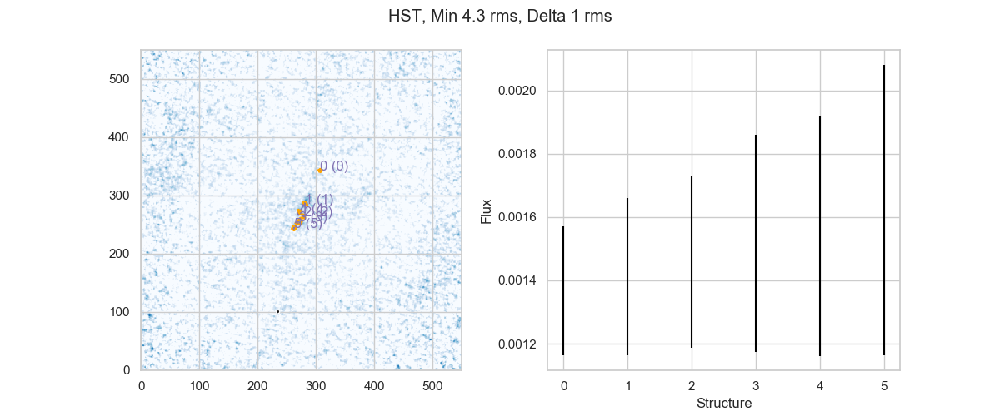

In [20]:
d_test_max = Dendrogram.compute(crop_data,min_value=(4.2)*rms,min_delta=1*rms,min_npix=0,is_independent=all_true((is_inside_hst,min_beam_size)))
p_test_max = d_test_max.plotter()
plot_to_compare(d_test_max,p_test_max,'HST, Min 4.3 rms, Delta 1 rms',im=alma_im)
cat_test_max = ppv_catalog(d_test_max.leaves, metadata,verbose=False)

There is one clump missing (number 5). We have to add some zero data for that one and check if the idx of the new catalog matches the final one.

Probably this is a bit too complex for this galaxy, but let's use the same functions as used for A521

In [21]:
def is_same_clump_2d(cat1,cat2):
    print('Cat1\tCat2\t_idx1\t_idx2\tDistance')
    new_order = []
    translate = {}
    no_match = []
    for c in cat1:
        dist = [np.sqrt((t['x_cen']- c['x_cen'])**2 + (t['y_cen']- c['y_cen'])**2) for t in cat2]
        print('%d\t%d\t%d\t%d\t%0.2f'%(c.index,np.argmin(dist),c['_idx'],cat2['_idx'][np.argmin(dist)],np.min(dist)))
        if np.min(dist) < 4:
            new_order.append([np.argmin(dist),c.index])
            translate[c.index] = cat2['_idx'][np.argmin(dist)]
        else:
            no_match.append(c.index)
    print('No match for ',no_match)
    return new_order,translate

In [22]:
def re_order_catalogue(cat,new_order,missing,fiducial_cat):
    
    new_order.sort(key = lambda x:x[0])
    good_order = np.transpose(new_order)[1]
    
    new_cat = cat.copy()
    new_cat.add_column(Column(name='new_idx', data=good_order),index=0)
    
    # Add missing columns
    for miss in missing:
        row = fiducial_cat[miss]
        data_dict = {k:0 for k,i in zip(row.colnames,row)} 
        data_dict['new_idx'] = miss
        data_dict['_idx'] = -99
        new_cat.add_row(data_dict)
            
    new_cat.sort(['new_idx'])
    new_cat.remove_column('new_idx')
    
    return new_cat

In [23]:
new_order_max, translate_max = is_same_clump_2d(cat_final,cat_test_max)

Cat1	Cat2	_idx1	_idx2	Distance
0	0	0	0	0.26
1	1	1	1	0.16
2	2	2	2	0.15
3	4	3	4	0.79
4	3	4	3	0.14
5	5	6	5	31.37
6	5	7	5	0.02
No match for  [5]


In [24]:
cat_test_max = re_order_catalogue(cat_test_max,new_order_max,[5],cat_final)

**Fmin = Fmin_fiducial-0.5 RMS**

<IPython.core.display.Javascript object>


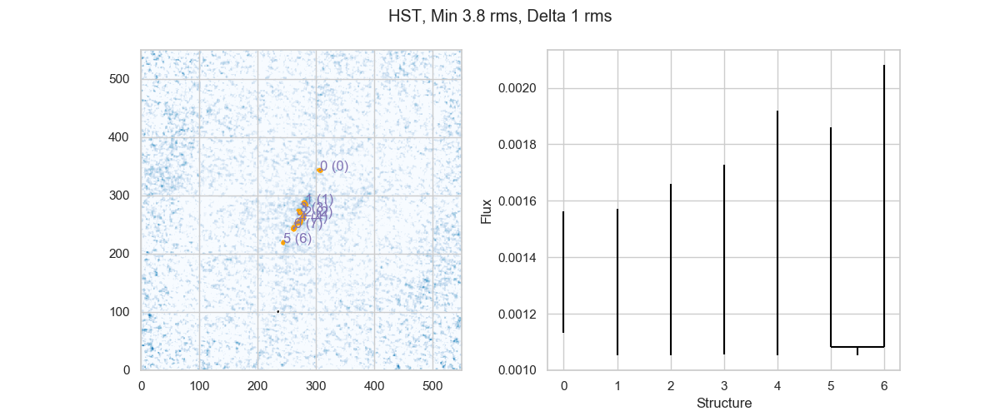

In [25]:
plot_to_compare(d_final,p_final,'HST, Min 3.8 rms, Delta 1 rms',im=alma_im)

<IPython.core.display.Javascript object>


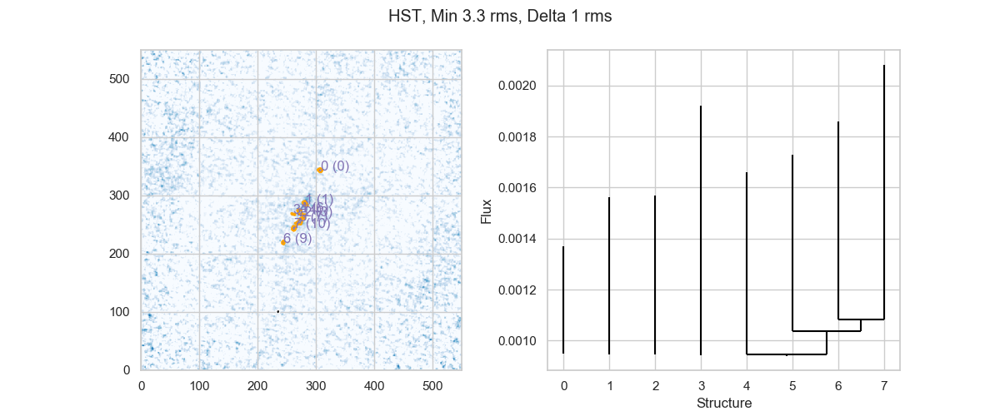

In [26]:
d_test_min = Dendrogram.compute(crop_data,min_value=(3.4)*rms,min_delta=1*rms,min_npix=0,is_independent=all_true((is_inside_hst,min_beam_size)))
p_test_min = d_test_min.plotter()
plot_to_compare(d_test_min,p_test_min,'HST, Min 3.3 rms, Delta 1 rms',im=alma_im)
cat_test_min = ppv_catalog(d_test_min.leaves, metadata,verbose=False) 

One more clump: we need to take it out and to match the numbers of the clumps

In [27]:
test,_ = is_same_clump_2d(cat_test_min,cat_final)

Cat1	Cat2	_idx1	_idx2	Distance
0	0	0	0	0.33
1	1	1	1	0.26
2	2	3	2	0.00
3	3	4	3	11.23
4	3	6	3	0.10
5	4	7	4	0.00
6	5	9	6	0.26
7	6	10	7	0.00
No match for  [3]


In [28]:
cat_test_min.remove_rows([3])

In [29]:
new_order_min, translate_min = is_same_clump_2d(cat_final,cat_test_min)

Cat1	Cat2	_idx1	_idx2	Distance
0	0	0	0	0.33
1	1	1	1	0.26
2	2	2	3	0.00
3	3	3	6	0.10
4	4	4	7	0.00
5	5	6	9	0.26
6	6	7	10	0.00
No match for  []


In [30]:
cat_test_min = re_order_catalogue(cat_test_min,new_order_min,[],cat_final)

<IPython.core.display.Javascript object>


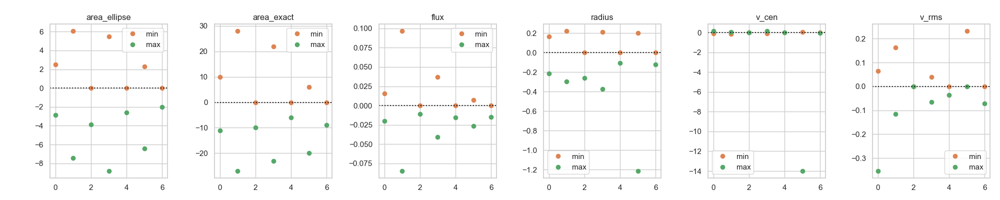

<IPython.core.display.Javascript object>


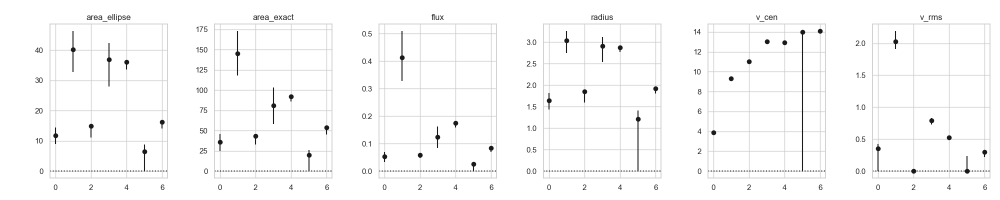

In [31]:
fig, ax = plt.subplots(1,6,figsize=(20,4))
fig.subplots_adjust(left=0.05,right=0.99,wspace=0.4)

for i, col in enumerate(['area_ellipse','area_exact','flux','radius','v_cen','v_rms']):
    ax[i].plot(cat_test_min[col]-cat_final[col],marker='o',linestyle='',color='C1',label='min')
    ax[i].plot(cat_test_max[col]-cat_final[col],marker='o',linestyle='',color='C2',label='max')
    ax[i].set_title(col)
    ax[i].axhline(0,color='k',linestyle=':')
    ax[i].legend()
    

fig, ax = plt.subplots(1,6,figsize=(20,4))
fig.subplots_adjust(left=0.05,right=0.99,wspace=0.4)
for i, col in enumerate(['area_ellipse','area_exact','flux','radius','v_cen','v_rms']):
    ax[i].errorbar(x=range(len(cat_final)),y=cat_final[col],yerr=[cat_final[col]-cat_test_max[col],cat_test_min[col]-cat_final[col]],marker='o',linestyle='',color='k')
    ax[i].set_title(col)
    ax[i].axhline(0,color='k',linestyle=':')

**Now do all again but with physical units**

In [32]:
phys_metadata = {}
phys_metadata['data_unit'] = u.Jy / u.beam
phys_metadata['velocity_scale'] = 29.940078 *u.km/u.second
phys_metadata['spatial_scale'] =  abs(header['CDELT1']) * u.deg 
phys_metadata['beam_major'] =  header['BMAJ'] * u.deg # FWHM for astrodendro to work
phys_metadata['beam_minor'] =  header['BMIN'] * u.deg # FWHM for astrodendro to work
phys_metadata['wcs'] = wcs_cube

beam_area = np.pi /(4*np.log(2)) * phys_metadata['beam_major'].value * phys_metadata['beam_minor'].value

In [33]:
cat_final =  ppv_catalog(d_final.leaves, phys_metadata,verbose=False) 
cat_test_max = ppv_catalog(d_test_max.leaves, phys_metadata,verbose=False) 
cat_test_max = re_order_catalogue(cat_test_max,new_order_max,[5],cat_final)

cat_test_min = ppv_catalog(d_test_min.leaves, phys_metadata,verbose=False) 
cat_test_min.remove_rows([3])
cat_test_min = re_order_catalogue(cat_test_min,new_order_min,[],cat_final)

<IPython.core.display.Javascript object>


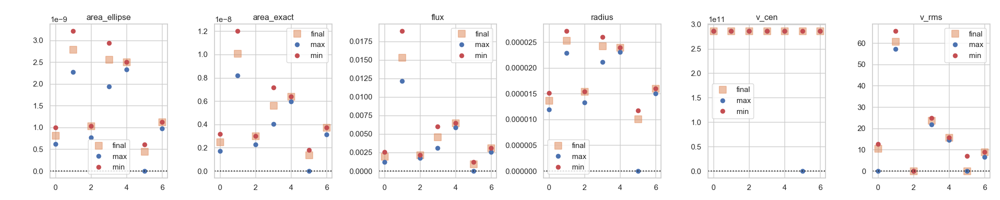

<IPython.core.display.Javascript object>


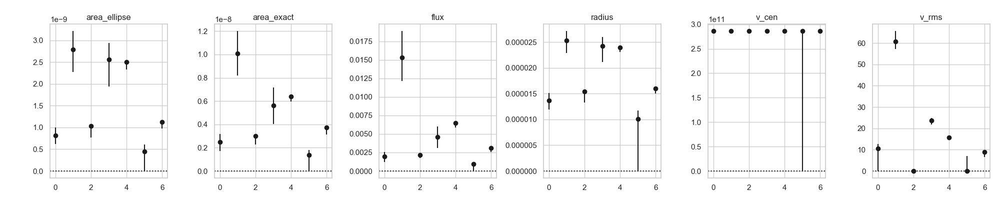

In [34]:
fig, ax = plt.subplots(1,6,figsize=(20,4))
fig.subplots_adjust(left=0.05,right=0.99,wspace=0.4)

for i, col in enumerate(['area_ellipse','area_exact','flux','radius','v_cen','v_rms']):
    ax[i].plot(cat_final[col],marker='s',linestyle='',color='C1',label='final',markersize=10,alpha=0.5)
    ax[i].plot(cat_test_max[col],marker='o',linestyle='',color='C0',label='max')
    ax[i].plot(cat_test_min[col],marker='o',linestyle='',color='C3',label='min')
    ax[i].set_title(col)
    ax[i].axhline(0,color='k',linestyle=':')
    ax[i].legend()
    

fig, ax = plt.subplots(1,6,figsize=(20,4))
fig.subplots_adjust(left=0.05,right=0.99,wspace=0.4)
for i, col in enumerate(['area_ellipse','area_exact','flux','radius','v_cen','v_rms']):
    ax[i].errorbar(x=range(len(cat_final)),y=cat_final[col],yerr=[cat_final[col]-cat_test_max[col],cat_test_min[col]-cat_final[col]],marker='o',linestyle='',color='k')
    ax[i].set_title(col)
    ax[i].axhline(0,color='k',linestyle=':')

Add uncertainties

In [35]:
for col in cat_final.colnames[1:]:
    if col+'_uerr' not in cat_final.colnames:
        err_low = cat_final[col]-cat_test_max[col]
        err_up = cat_test_min[col]-cat_final[col]
        new_col1 = Column(name=col+'_uerr',data=err_up,unit=cat_final[col].unit)
        new_col2 = Column(name=col+'_lerr',data=err_low,unit=cat_final[col].unit)
        cat_final.add_columns([new_col1,new_col2])
cat_final.show_in_notebook()

idx,_idx,area_ellipse,area_exact,flux,major_sigma,minor_sigma,position_angle,radius,v_cen,v_rms,x_cen,y_cen,area_ellipse_uerr,area_ellipse_lerr,area_exact_uerr,area_exact_lerr,flux_uerr,flux_lerr,major_sigma_uerr,major_sigma_lerr,minor_sigma_uerr,minor_sigma_lerr,position_angle_uerr,position_angle_lerr,radius_uerr,radius_lerr,v_cen_uerr,v_cen_lerr,v_rms_uerr,v_rms_lerr,x_cen_uerr,x_cen_lerr,y_cen_uerr,y_cen_lerr
,,deg2,deg2,Jy,deg,deg,deg,deg,,km / s,,,deg2,deg2,deg2,deg2,Jy,Jy,deg,deg,deg,deg,deg,deg,deg,deg,,,km / s,km / s,,,,
0,0,8.206544839635461e-10,2.4999999999998e-09,0.0019743705705997225,1.6402658850597414e-05,1.1488098716521363e-05,176.31140835924685,1.3727176114885607e-05,286363033451.29095,10.594153687132055,342.1736803153953,-44.531886834793795,1.7496215122217636e-10,1.9913074138626103e-10,6.944444444443888e-10,7.638888888888278e-10,0.0005889104518413363,0.0007399458706719055,9.980613725762372e-07,3.820903031367823e-06,1.6498325195488136e-06,1.4534413308899522e-07,-7.898217982585379,336.3193210358461,1.39266071459609e-06,1.78097301573342e-06,2319130.108276367,4202377.683044434,1.9615088828086389,10.594153687132055,-3.77810306417814e-06,7.587936465824896e-07,4.046063821760981e-07,2.0678077987668075e-06
1,1,2.794695792235887e-09,1.0069444444443638e-08,0.015319057111455111,3.302368967295042e-05,1.9431709573559446e-05,52.80939828518813,2.5331931366797262e-05,286206689681.4802,60.751564152491696,342.17398684778954,-44.53236239992015,4.2156468081827695e-10,5.168378797940235e-10,1.9444444444442887e-09,1.8749999999998497e-09,0.0035854989766700342,0.0031450114563692094,2.5849265610947776e-06,3.366301725846156e-06,1.3077855875828933e-06,1.7958839334860742e-06,-0.8205013527568994,0.8521657413790038,1.843512034938706e-06,2.4620270649610963e-06,3554407.1337890625,2636905.533996582,4.89511095300746,3.4459229791378903,-1.1536093893482757e-06,-2.1713924525101902e-07,1.9676355833553316e-06,1.2879818029887247e-06
2,2,1.0379880205021143e-09,2.986111111110872e-09,0.0021924783107259535,1.8944065417993278e-05,1.2581175510563176e-05,89.66378013131792,1.5438219194821785e-05,286158361487.41187,0.0,342.1740094465627,-44.53254623719655,0.0,2.6876588008563464e-10,0.0,6.944444444443888e-10,0.0,0.0004102910844078222,0.0,3.0499808390462887e-06,0.0,1.4685079979517081e-06,0.0,-13.638991598973377,0.0,2.1481598517201468e-06,0.0,0.0,0.0,0.0,0.0,-1.5910148363218468e-06,0.0,6.010587298987957e-07
3,3,2.55637410656109e-09,5.62499999999955e-09,0.004602823561880355,3.104359352474695e-05,1.8908387154084337e-05,63.88390829415955,2.422775856367941e-05,286100268746.1562,23.722173093826342,342.1740918452436,-44.53248637861228,3.8175420055238123e-10,6.121866192350924e-10,1.5277777777776555e-09,1.5972222222220945e-09,0.0013841565210977293,0.0015001145095835562,6.752817782331415e-07,1.3890378838430384e-06,2.361003213304131e-06,3.854495453786531e-06,4.142685691792678,2.2669955441868836,1.746096383817326e-06,3.0991885922255242e-06,2366326.7436523438,4850553.886169434,1.2008446309564498,1.9409779977902488,-1.0375277383900539e-06,-2.8358112444948347e-06,-3.0453801258545354e-07,6.234356938250585e-06
4,4,2.506669499947401e-09,6.388888888888377e-09,0.006460008482845096,3.504030542486294e-05,1.642597880535973e-05,-136.1135053023253,2.3991067384385596e-05,286102147682.8218,15.603663445227513,342.1740997754003,-44.53261971145968,0.0,1.7862884861895236e-10,0.0,4.166666666666332e-10,0.0,0.0005825882383017631,0.0,3.5690718647976067e-07,0.0,1.0135536249333814e-06,0.0,-0.35613880494662453,0.0,8.706158240892057e-07,0.0,907359.8571777344,0.0,1.056899852026561,0.0,-9.429564897800446e-07,0.0,9.728219438898122e-07
5,6,4.4506461196574956e-10,1.3888888888887777e-09,0.000977744214340967,1.2867560443801916e-05,7.941982236452097e-06,79.01199759256868,1.01091016648933e-05,286072445950.4707,0.0,342.17442408042865,-44.532920171573146,1.580295367148739e-10,4.4506461196574956e-10,4.166666666666332e-10,1.3888888888887777e-09,0.00025696537278424147,0.000977744214340967,1.3123228157031716e-06,1.2

Correct for beam size. There are a couple of clumps that have sizes too small

<IPython.core.display.Javascript object>


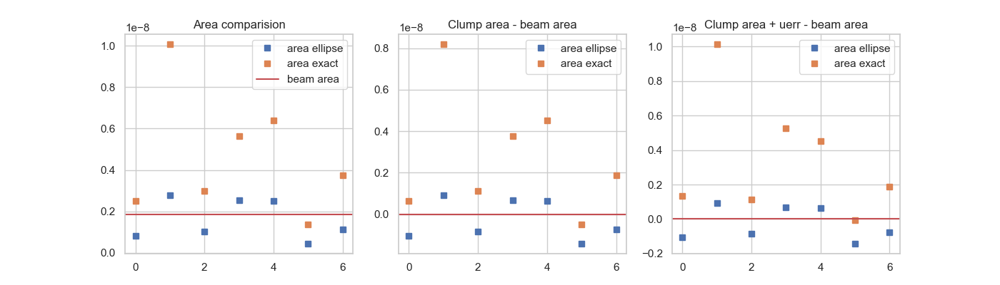

In [36]:
fig, ax = plt.subplots(1,3,figsize=(14,4))

ax[0].set_title('Area comparision')
ax[0].plot(cat_final['area_ellipse'],marker='s',linestyle='',label='area ellipse')
ax[0].plot(cat_final['area_exact'],marker='s',linestyle='',label='area exact')
ax[0].axhline(beam_area,color='r',label='beam area')
ax[0].legend()

ax[1].set_title('Clump area - beam area')
ax[1].plot(cat_final['area_ellipse']-beam_area,marker='s',linestyle='',label='area ellipse')
ax[1].plot(cat_final['area_exact']-beam_area,marker='s',linestyle='',label='area exact')
ax[1].axhline(0,color='r')
ax[1].legend()

ax[2].set_title('Clump area + uerr - beam area')
ax[2].plot(cat_final['area_ellipse']-beam_area,marker='s',linestyle='',label='area ellipse')
ax[2].plot(cat_final['area_exact']+ cat_final['area_exact_uerr']-beam_area,marker='s',linestyle='',label='area exact')
ax[2].axhline(0,color='r')
ax[2].legend()

In [37]:
def deconvolve_radius(catalogue,metadata):
    beam_area = np.pi /(4*np.log(2)) * metadata['beam_major'].value * metadata['beam_minor'].value
    corrected_area = catalogue['area_exact'] - beam_area
    corrected_radius = np.sqrt(corrected_area/np.pi)
    corrected_radius_lerr = 1/2 * 1/np.sqrt(np.pi) * 1/np.sqrt(corrected_area) * catalogue['area_exact_lerr']
    corrected_radius_uerr = 1/2 * 1/np.sqrt(np.pi) * 1/np.sqrt(corrected_area) * catalogue['area_exact_uerr']
    
    # Check if there are negative values
    not_ok = np.where(np.isnan(corrected_radius))
    corrected_area[not_ok] = catalogue['area_exact'][not_ok]
    corrected_radius[not_ok] = np.sqrt(catalogue['area_exact'][not_ok]/np.pi)
    corrected_radius_uerr[not_ok] = 1/2 * 1/np.sqrt(np.pi) * 1/np.sqrt(catalogue['area_exact'][not_ok]) * catalogue['area_exact_uerr'][not_ok]
    corrected_radius_lerr[not_ok] = np.sqrt(catalogue['area_exact'][not_ok]/np.pi)
    higher_limit = np.zeros_like(corrected_radius)
    higher_limit[not_ok] = 1
    
    # Old way. I think it's confusing because upper limits are not very clear
    '''if np.any(np.isnan(corrected_radius)):
        bad_radius = np.where(np.isnan(corrected_radius))
        for c in bad_radius:
            corrected_area = catalogue[c]['area_exact'] + catalogue[c]['area_exact_uerr'] - beam_area
            corrected_radius[c] = np.sqrt(corrected_area/np.pi)
            corrected_radius_lerr[c] = 1/2 * 1/np.sqrt(np.pi) * 1/np.sqrt(corrected_area) * catalogue[c]['area_exact_lerr']
            corrected_radius_uerr[c] = 0
    '''
    
    catalogue.add_column(Column(name='corrected_area', data=corrected_area, unit=u.deg**2))
    catalogue.add_column(Column(name='radius_corrected', data=corrected_radius, unit=u.deg))
    catalogue.add_column(Column(name='radius_corrected_lerr', data=corrected_radius_lerr, unit=u.deg))
    catalogue.add_column(Column(name='radius_corrected_uerr', data=corrected_radius_uerr, unit=u.deg))
    catalogue.add_column(Column(name='radius_not_corrected', data=higher_limit))

    return catalogue

In [38]:
cat_final = deconvolve_radius(cat_final,phys_metadata)
cat_final.show_in_notebook()

idx,_idx,area_ellipse,area_exact,flux,major_sigma,minor_sigma,position_angle,radius,v_cen,v_rms,x_cen,y_cen,area_ellipse_uerr,area_ellipse_lerr,area_exact_uerr,area_exact_lerr,flux_uerr,flux_lerr,major_sigma_uerr,major_sigma_lerr,minor_sigma_uerr,minor_sigma_lerr,position_angle_uerr,position_angle_lerr,radius_uerr,radius_lerr,v_cen_uerr,v_cen_lerr,v_rms_uerr,v_rms_lerr,x_cen_uerr,x_cen_lerr,y_cen_uerr,y_cen_lerr,corrected_area,radius_corrected,radius_corrected_lerr,radius_corrected_uerr,radius_not_corrected
,,deg2,deg2,Jy,deg,deg,deg,deg,,km / s,,,deg2,deg2,deg2,deg2,Jy,Jy,deg,deg,deg,deg,deg,deg,deg,deg,,,km / s,km / s,,,,,deg2,deg,deg,deg,deg2
0,0,8.206544839635461e-10,2.4999999999998e-09,0.0019743705705997225,1.6402658850597414e-05,1.1488098716521363e-05,176.31140835924685,1.3727176114885607e-05,286363033451.29095,10.594153687132055,342.1736803153953,-44.531886834793795,1.7496215122217636e-10,1.9913074138626103e-10,6.944444444443888e-10,7.638888888888278e-10,0.0005889104518413363,0.0007399458706719055,9.980613725762372e-07,3.820903031367823e-06,1.6498325195488136e-06,1.4534413308899522e-07,-7.898217982585379,336.3193210358461,1.39266071459609e-06,1.78097301573342e-06,2319130.108276367,4202377.683044434,1.9615088828086389,10.594153687132055,-3.77810306417814e-06,7.587936465824896e-07,4.046063821760981e-07,2.0678077987668075e-06,6.286171290912818e-10,1.414549563692369e-05,8.594728368674722e-06,7.813389426067927e-06,0.0
1,1,2.794695792235887e-09,1.0069444444443638e-08,0.015319057111455111,3.302368967295042e-05,1.9431709573559446e-05,52.80939828518813,2.5331931366797262e-05,286206689681.4802,60.751564152491696,342.17398684778954,-44.53236239992015,4.2156468081827695e-10,5.168378797940235e-10,1.9444444444442887e-09,1.8749999999998497e-09,0.0035854989766700342,0.0031450114563692094,2.5849265610947776e-06,3.366301725846156e-06,1.3077855875828933e-06,1.7958839334860742e-06,-0.8205013527568994,0.8521657413790038,1.843512034938706e-06,2.4620270649610963e-06,3554407.1337890625,2636905.533996582,4.89511095300746,3.4459229791378903,-1.1536093893482757e-06,-2.1713924525101902e-07,1.9676355833553316e-06,1.2879818029887247e-06,8.19806157353512e-09,5.10835007257693e-05,5.841720204323093e-06,6.058080211890615e-06,0.0
2,2,1.0379880205021143e-09,2.986111111110872e-09,0.0021924783107259535,1.8944065417993278e-05,1.2581175510563176e-05,89.66378013131792,1.5438219194821785e-05,286158361487.41187,0.0,342.1740094465627,-44.53254623719655,0.0,2.6876588008563464e-10,0.0,6.944444444443888e-10,0.0,0.0004102910844078222,0.0,3.0499808390462887e-06,0.0,1.4685079979517081e-06,0.0,-13.638991598973377,0.0,2.1481598517201468e-06,0.0,0.0,0.0,0.0,0.0,-1.5910148363218468e-06,0.0,6.010587298987957e-07,1.114728240202354e-09,1.8836905777347526e-05,5.8674321219433735e-06,0.0,0.0
3,3,2.55637410656109e-09,5.62499999999955e-09,0.004602823561880355,3.104359352474695e-05,1.8908387154084337e-05,63.88390829415955,2.422775856367941e-05,286100268746.1562,23.722173093826342,342.1740918452436,-44.53248637861228,3.8175420055238123e-10,6.121866192350924e-10,1.5277777777776555e-09,1.5972222222220945e-09,0.0013841565210977293,0.0015001145095835562,6.752817782331415e-07,1.3890378838430384e-06,2.361003213304131e-06,3.854495453786531e-06,4.142685691792678,2.2669955441868836,1.746096383817326e-06,3.0991885922255242e-06,2366326.7436523438,4850553.886169434,1.2008446309564498,1.9409779977902488,-1.0375277383900539e-06,-2.8358112444948347e-06,-3.0453801258545354e-07,6.234356938250585e-06,3.753617129091032e-09,3.4566073556863434e-05,7.354199818636705e-06,7.034452000435109e-06,0.0
4,4,2.506669499947401e-09,6.388888888888377e-09,0.006460008482845096,3.504030542486294e-05,1.642597880535973e-05,-136.1135053023253,2.3991067384385596e-05,286102147682.8218,15.603663445227513,342.1740997754003,-44.53261971145968,0.0,1.7862884861895236e-10,0.0,4.166666666666332e-10,0.0,0.0005825882383017631,0.0,3.5690718647976067e-07,0.0,1.0135536249333814e-06,0.0,-0.35613880494662453,0.0,8.706158240892057e-07,0.0

<IPython.core.display.Javascript object>


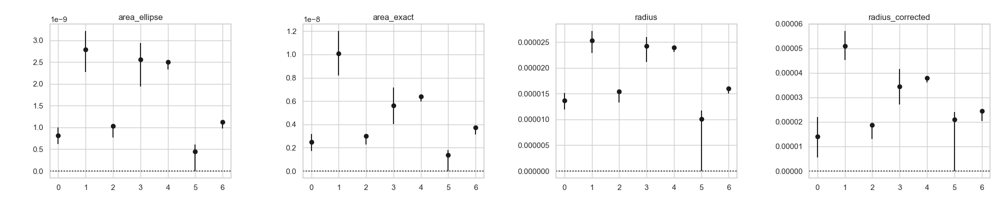

In [39]:
fig, ax = plt.subplots(1,4,figsize=(20,4))
fig.subplots_adjust(left=0.05,right=0.99,wspace=0.4)
for i, col in enumerate(['area_ellipse','area_exact','radius']):
    ax[i].errorbar(x=range(len(cat_final)),y=cat_final[col],yerr=[cat_final[col]-cat_test_max[col],cat_test_min[col]-cat_final[col]],marker='o',linestyle='',color='k')
    ax[i].set_title(col)
    ax[i].axhline(0,color='k',linestyle=':')
    
ax[3].errorbar(x=range(len(cat_final)),y=cat_final['radius_corrected'],yerr=[cat_final['radius_corrected_lerr'],cat_final['radius_corrected_uerr']],marker='o',linestyle='',color='k')
ax[3].set_title('radius_corrected')
ax[3].axhline(0,color='k',linestyle=':')

## Extract spectra from clumps and fit line width

In [40]:
from astropy.modeling import models 
sns.set_style('whitegrid')

def fit_with_gaussian(leaf,sp,xaxis,plot=True):
    xaxis = range(len(sp))
    g = models.Gaussian1D(amplitude=0.1, mean=leaf.get_peak()[0][0], stddev=5)
    fit = fitting.LevMarLSQFitter()
    fit_g = fit(g, xaxis, sp)
    if plot:
        ax[n].plot(fit_g(xaxis),color='red',linewidth=1.5,label='fit',linestyle=':')
    std = fit_g.stddev.value*phys_metadata['velocity_scale']
    return std.value
    
    
def extract_spectrum(im_mask):
    sp = 0
    qq, pp = np.where(im_mask)
    for (p,q)in zip(qq,pp):
        sp += crop_data[:,p,q]
    xaxis = range(len(sp))
    return sp, xaxis

def deconvolve_channel(width):
    return np.sqrt(width**2 - phys_metadata['velocity_scale'].value**2/(2*np.pi))


<IPython.core.display.Javascript object>


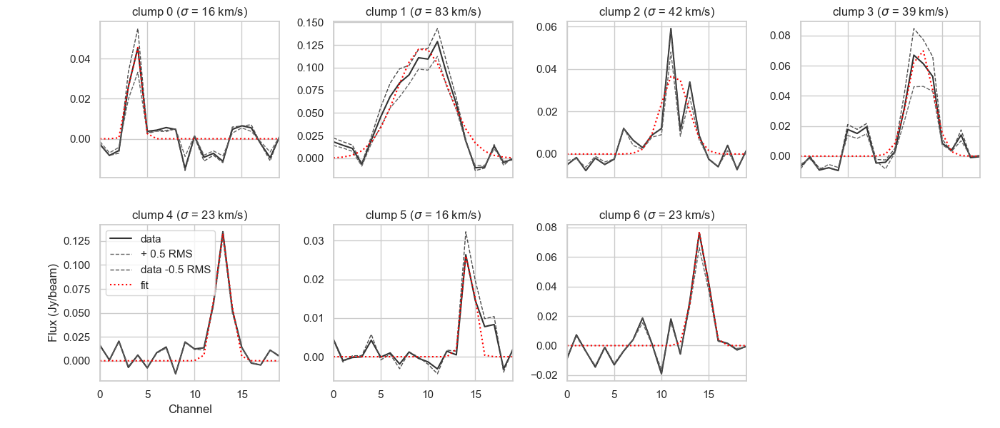

no clump for max
[10.856848046386613, 82.40531568381428, 41.2372411236159, 37.29011266125384, 20.365793740935455, 11.99506270179838, 20.314426590614406]
[0.8146279024858574, 2.7208000886110852, 0.39587038776211614, 0.5112359130314168, 0.12392295797817532, 9.751758112363937, 0.07871640358349374]


In [41]:
bg_spec = np.nanmean(crop_data[:,280:340,190:240],axis=(1,2))
fig, ax = plt.subplots(2,4,figsize=(14,6))
fig.subplots_adjust(top=0.95,left=0.1,right=0.98,hspace=0.3,wspace=0.3)
ax = ax.ravel()
width = []
width_channel_corrected = []
width_unc = []


from_n_to_idx_max = {l.idx:n for n,l in enumerate(d_test_max.leaves)}
from_n_to_idx_min = {l.idx:n for n,l in enumerate(d_test_min.leaves)}
    
    
for n in range(len(cat_final)):
    
    leaf = d_final.leaves[idx_to_dendro_idx[n]]
    
    # spectrum from final selection
    im_mask = np.nansum(leaf.get_mask(),axis=0)
    im_mask[im_mask >0] = 1
    sp, xaxis = extract_spectrum(im_mask)
    ax[n].plot(sp,color='0.2',linewidth=1.5,label='data')
   
    # Spectrum from Fmin+0.5rms
    hidden_idx_max = translate_max.get(n,None) # n to _idx
    n_max = from_n_to_idx_max.get(hidden_idx_max,None) # _idx to position
    if n_max is None:
        print('no clump for max')
        std_max = 0
    else:
        leaf_max = d_test_max.leaves[n_max]
        im_mask_max = np.nansum(leaf_max.get_mask(),axis=0)
        sp_max,_ = extract_spectrum(im_mask_max)
        ax[n].plot(sp_max,color='0.4',linewidth=1.,linestyle='--',label='+ 0.5 RMS')
        std_max = fit_with_gaussian(leaf_max,sp_max,xaxis,plot=False)
    
    # Spectrum from Fmin-0.5rms
    hidden_idx_min = translate_min.get(n,None) # n to _idx
    n_min = from_n_to_idx_min.get(hidden_idx_min,None) # _idx to position
    if n_min is None:
        print('no clump for min')
        std_min = 0
    else:
        leaf_min = d_test_min.leaves[n_min]
        im_mask_min = np.nansum(leaf_min.get_mask(),axis=0)
        sp_min,_ = extract_spectrum(im_mask_min)
        ax[n].plot(sp_min,color='0.3',linewidth=1.,linestyle='--',label='data -0.5 RMS')
        std_min = fit_with_gaussian(leaf_min,sp_min,xaxis,plot=False)
    
    # Fit with Gaussian
    std = fit_with_gaussian(leaf,sp,xaxis)
    ax[n].set_title('clump %d ($\sigma$ = %d km/s)'%(n,std))
    
    #print('%0.2f + %0.2f - %0.2f'%(std,std_min,std_max))
    width.append(std)
    width_channel_corrected.append(deconvolve_channel(std))
    width_unc.append(np.mean((abs(std-std_min),abs(std-std_max))))

    ax[n].set_xlim(0,19)
    
ax[4].legend()
ax[4].set_ylabel('Flux (Jy/beam)')
ax[4].set_xlabel('Channel')
ax[7].axis('off')

for x in ax[:4]:
    x.set_xticklabels([])
    
print(width_channel_corrected)
print(width_unc)

fig.savefig('../Plots/as1063_spectra.jpeg')

Add this to final catalogue

In [43]:
cat_final.add_column(Column(name='measured_line_width', data=width, unit='km/s'))
cat_final.add_column(Column(name='line_width', data=width_channel_corrected, unit='km/s'))
cat_final.add_column(Column(name='line_width_unc', data=width_unc, unit='km/s'))

In [44]:
cat_final.write('as1063_catalogue.txt',format='ascii.fixed_width_two_line')
cat_final.write('as1063_catalogue.fits')

## Same thing but for noise

In [42]:
def deconvolve_radius_noise(catalogue,metadata):
    beam_area = np.pi /(4*np.log(2)) * metadata['beam_major'].value * metadata['beam_minor'].value
    corrected_area = catalogue['area_exact'] - beam_area
    corrected_radius = np.sqrt(corrected_area/np.pi)
    
    ## Test the ones that are smaller than the area
    not_ok = np.where(np.isnan(corrected_radius))
    corrected_area[not_ok] = catalogue['area_exact'][not_ok]
    higher_limit = np.zeros_like(corrected_radius)
    higher_limit[not_ok] = 1 
    corrected_radius[not_ok] = np.sqrt(catalogue['area_exact']/np.pi)[not_ok]
    
    catalogue.add_column(Column(name='corrected_area', data=corrected_area, unit=u.deg))
    catalogue.add_column(Column(name='radius_corrected', data=corrected_radius, unit=u.deg))
    catalogue.add_column(Column(name='radius_not_corrected', data=higher_limit))

    return catalogue

In [43]:
cat_noise =  ppv_catalog(d_noise.leaves, phys_metadata,verbose=False) 
cat_noise = deconvolve_radius_noise(cat_noise,phys_metadata)
cat_noise.show_in_notebook()

idx,_idx,area_ellipse,area_exact,flux,major_sigma,minor_sigma,position_angle,radius,v_cen,v_rms,x_cen,y_cen,corrected_area,radius_corrected,radius_not_corrected
,,deg2,deg2,Jy,deg,deg,deg,deg,,km / s,,,deg,deg,deg2
0,0,4.958944294538886e-10,1.2499999999999e-09,0.000617240691156519,1.202799798056268e-05,9.466685462027009e-06,84.26141937904885,1.067076724607387e-05,286330192561.2942,0.0,342.1732866958011,-44.53374577712488,1.2499999999999e-09,1.9947114020070838e-05,1.0
1,1,5.792059704922885e-10,1.7361111111109721e-09,0.000866682217098306,1.5922960904039346e-05,8.352399631191528e-06,160.04321652290255,1.1532342900832222e-05,286330192561.2942,0.0,342.1727507215523,-44.53311948777037,1.7361111111109721e-09,2.3507899314488903e-05,1.0
2,2,9.14571876311059e-10,1.8749999999998497e-09,0.0009972619735446556,1.876408496400042e-05,1.1191608668618633e-05,84.16589636158844,1.4491386957148154e-05,286159200483.5576,5.048950060462797,342.17257765750855,-44.53361290300286,3.617129091331622e-12,1.073018149601323e-06,0.0
3,3,6.054794489236884e-10,1.7361111111109721e-09,0.0009055440034117842,1.561799154616447e-05,8.90176833849371e-06,-165.70325065259667,1.1791002614557818e-05,286184086442.45215,9.050895811421015,342.17286126044326,-44.532345396146596,1.7361111111109721e-09,2.3507899314488903e-05,1.0
4,4,1.2972466092166695e-09,3.055555555555311e-09,0.001676742152780645,2.0643260668157766e-05,1.4429334854617943e-05,-151.29918449213355,1.7258867885003715e-05,286158361487.41187,0.0,342.17212147075685,-44.53371183652017,1.184172684646793e-09,1.9414784893783256e-05,0.0
5,5,4.6558594684155946e-10,1.3194444444443387e-09,0.0006827046060317938,1.3820899296264224e-05,7.73509451958414e-06,162.14742671987963,1.0339533954790114e-05,286158361487.41187,0.0,342.1723431381675,-44.53373734263666,1.3194444444443387e-09,2.0493711497357242e-05,1.0
6,6,6.82721632400174e-10,1.7361111111109721e-09,0.0008696520677976944,1.916953395084483e-05,8.177756479659692e-06,132.37903037157005,1.2520534352757384e-05,286158361487.41187,0.0,342.17324056777846,-44.533092235246244,1.7361111111109721e-09,2.3507899314488903e-05,1.0
7,7,1.3889047984590352e-09,3.2638888888886276e-09,0.001742057609572747,3.485685504330306e-05,9.149267856987657e-06,152.2471825424349,1.7858183094687175e-05,286158361487.41187,0.0,342.1720456767425,-44.53258608764406,1.3925060179801096e-09,2.105346603515659e-05,0.0
8,8,6.187483232764733e-10,1.4583333333332165e-09,0.0007876245002711079,1.3287151017151131e-05,1.0692622349670156e-05,61.48749835269135,1.1919500322137363e-05,286158361487.41187,0.0,342.1725538656473,-44.53135665779075,1.4583333333332165e-09,2.154534560760918e-05,1.0


Spectra

<IPython.core.display.Javascript object>


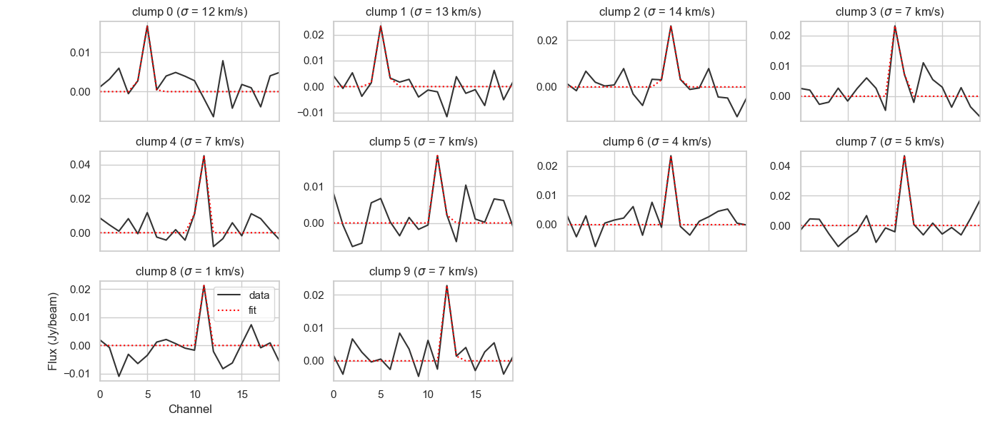

In [44]:
bg_spec = np.nanmean(crop_data[:,280:340,190:240],axis=(1,2))
fig, ax = plt.subplots(3,4,figsize=(14,6))
fig.subplots_adjust(top=0.95,left=0.1,right=0.98,hspace=0.3,wspace=0.3)
ax = ax.ravel()
width_noise = []
width_channel_corrected_noise = []


def fit_with_gaussian(leaf,sp,xaxis,plot=True):
    xaxis = range(len(sp))
    g = models.Gaussian1D(amplitude=0.02, mean=leaf.get_peak()[0][0], stddev=1)
    fit = fitting.LevMarLSQFitter()
    fit_g = fit(g, xaxis, sp)
    if plot:
        ax[n].plot(fit_g(xaxis),color='red',linewidth=1.5,label='fit',linestyle=':')
    std = fit_g.stddev.value*phys_metadata['velocity_scale']
    return std.value
    
    
for leaf in d_noise.leaves: # there is no hierarchical structure, so the order is simpler
        
    n = leaf.idx
    
    # spectrum from final selection
    im_mask = np.nansum(leaf.get_mask(),axis=0)
    im_mask[im_mask >0] = 1
    sp, xaxis = extract_spectrum(im_mask)
    ax[n].plot(sp,color='0.2',linewidth=1.5,label='data')
    
    # Fit with Gaussian
    std = fit_with_gaussian(leaf,sp,xaxis)
    ax[n].set_title('clump %d ($\sigma$ = %d km/s)'%(n,std))
    
    width_noise.append(std)
    width_channel_corrected_noise.append(deconvolve_channel(std))

    ax[n].set_xlim(0,19)
    
ax[8].legend()
ax[8].set_ylabel('Flux (Jy/beam)')
ax[8].set_xlabel('Channel')
ax[10].axis('off')
ax[11].axis('off')

for x in ax[:8]:
    x.set_xticklabels([])
    
fig.savefig('../Plots/as1063_noise_spectra.jpeg')

Add to catalogue

In [47]:
width_channel_corrected_noise = np.array(width_channel_corrected_noise)
width_noise = np.array(width_noise)

## Test the line width that are smaller than the channel width
not_ok = np.where(np.isnan(width_channel_corrected_noise))[0]
higher_limit = np.zeros_like(width_channel_corrected_noise)
higher_limit[not_ok] = 1 
width_channel_corrected_noise[not_ok] = width_noise[not_ok]

cat_noise.add_column(Column(name='line_width', data=width_channel_corrected_noise, unit='km/s'))
cat_noise.add_column(Column(name='line_width_not_corrected', data=higher_limit))

cat_noise.write('as1063_noise_catalogue.fits')

## Smaller catalogue

In [49]:
cat_final

_idx,area_ellipse,area_exact,flux,major_sigma,minor_sigma,position_angle,radius,v_cen,v_rms,x_cen,y_cen,area_ellipse_uerr,area_ellipse_lerr,area_exact_uerr,area_exact_lerr,flux_uerr,flux_lerr,major_sigma_uerr,major_sigma_lerr,minor_sigma_uerr,minor_sigma_lerr,position_angle_uerr,position_angle_lerr,radius_uerr,radius_lerr,v_cen_uerr,v_cen_lerr,v_rms_uerr,v_rms_lerr,x_cen_uerr,x_cen_lerr,y_cen_uerr,y_cen_lerr,corrected_area,radius_corrected,radius_corrected_lerr,radius_corrected_uerr,radius_not_corrected,measured_line_width,line_width,line_width_unc
,deg2,deg2,Jy,deg,deg,deg,deg,,km / s,,,deg2,deg2,deg2,deg2,Jy,Jy,deg,deg,deg,deg,deg,deg,deg,deg,,,km / s,km / s,,,,,deg2,deg,deg,deg,deg2,km / s,km / s,km / s
int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
0,8.206544839635461e-10,2.4999999999998e-09,0.0019743705705997225,1.6402658850597414e-05,1.1488098716521363e-05,176.31140835924685,1.3727176114885607e-05,286363033451.29095,10.594153687132055,342.1736803153953,-44.531886834793795,1.7496215122217636e-10,1.9913074138626103e-10,6.944444444443888e-10,7.638888888888278e-10,0.0005889104518413363,0.0007399458706719055,9.980613725762372e-07,3.820903031367823e-06,1.6498325195488136e-06,1.4534413308899522e-07,-7.898217982585379,336.3193210358461,1.39266071459609e-06,1.78097301573342e-06,2319130.108276367,4202377.683044434,1.9615088828086389,10.594153687132055,-3.77810306417814e-06,7.587936465824896e-07,4.046063821760981e-07,2.0678077987668075e-06,6.286171290912818e-10,1.414549563692369e-05,8.594728368674722e-06,7.813389426067927e-06,0.0,16.14121918580225,10.856848046386613,0.8146279024858574
1,2.794695792235887e-09,1.0069444444443638e-08,0.015319057111455111,3.302368967295042e-05,1.9431709573559446e-05,52.80939828518813,2.5331931366797262e-05,286206689681.4802,60.751564152491696,342.17398684778954,-44.53236239992015,4.2156468081827695e-10,5.168378797940235e-10,1.9444444444442887e-09,1.8749999999998497e-09,0.0035854989766700342,0.0031450114563692094,2.5849265610947776e-06,3.366301725846156e-06,1.3077855875828933e-06,1.7958839334860742e-06,-0.8205013527568994,0.8521657413790038,1.843512034938706e-06,2.4620270649610963e-06,3554407.1337890625,2636905.533996582,4.89511095300746,3.4459229791378903,-1.1536093893482757e-06,-2.1713924525101902e-07,1.9676355833553316e-06,1.2879818029887247e-06,8.19806157353512e-09,5.10835007257693e-05,5.841720204323093e-06,6.058080211890615e-06,0.0,83.26646299832166,82.40531568381428,2.7208000886110852
2,1.0379880205021143e-09,2.986111111110872e-09,0.0021924783107259535,1.8944065417993278e-05,1.2581175510563176e-05,89.66378013131792,1.5438219194821785e-05,286158361487.41187,0.0,342.1740094465627,-44.53254623719655,0.0,2.6876588008563464e-10,0.0,6.944444444443888e-10,0.0,0.0004102910844078222,0.0,3.0499808390462887e-06,0.0,1.4685079979517081e-06,0.0,-13.638991598973377,0.0,2.1481598517201468e-06,0.0,0.0,0.0,0.0,0.0,-1.5910148363218468e-06,0.0,6.010587298987957e-07,1.114728240202354e-09,1.8836905777347526e-05,5.8674321219433735e-06,0.0,0.0,42.932247353114654,41.2372411236159,0.39587038776211614
3,2.55637410656109e-09,5.62499999999955e-09,0.004602823561880355,3.104359352474695e-05,1.8908387154084337e-05,63.88390829415955,2.422775856367941e-05,286100268746.1562,23.722173093826342,342.1740918452436,-44.53248637861228,3.8175420055238123e-10,6.121866192350924e-10,1.5277777777776555e-09,1.5972222222220945e-09,0.0013841565210977293,0.0015001145095835562,6.752817782331415e-07,1.3890378838430384e-06,2.361003213304131e-06,3.854495453786531e-06,4.142685691792678,2.2669955441868836,1.746096383817326e-06,3.0991885922255242e-06,2366326.7436523438,4850553.886169434,1.2008446309564498,1.9409779977902488,-1.0375277383900539e-06,-2.8358112444948347e-06,

In [45]:
keeping_columns = ['_idx',
                   'flux', 'flux_lerr','flux_uerr',
                   'radius_corrected', 'radius_corrected_lerr','radius_corrected_uerr','radius_not_corrected', # radius corrected for beam size (mostly nans)
                   'corrected_area','area_exact_lerr','area_exact_uerr',
                   'line_width','line_width_unc'] # line width sigma corrected for channel width
    
cat_small = cat_final[keeping_columns]

In [46]:
cat_small.write('as1063_small_catalogue.fits')

In [52]:
cat_small.show_in_notebook()

idx,_idx,flux,flux_lerr,flux_uerr,radius_corrected,radius_corrected_lerr,radius_corrected_uerr,radius_not_corrected,corrected_area,area_exact_lerr,area_exact_uerr,line_width,line_width_unc
,,Jy,Jy,Jy,deg,deg,deg,deg2,deg2,deg2,deg2,km / s,km / s
0,0,0.0019743705705997225,0.0007399458706719055,0.0005889104518413363,1.414549563692369e-05,8.594728368674722e-06,7.813389426067927e-06,0.0,6.286171290912818e-10,7.638888888888278e-10,6.944444444443888e-10,10.856848046386613,0.8146279024858574
1,1,0.015319057111455111,0.0031450114563692094,0.0035854989766700342,5.10835007257693e-05,5.841720204323093e-06,6.058080211890615e-06,0.0,8.19806157353512e-09,1.8749999999998497e-09,1.9444444444442887e-09,82.40531568381428,2.7208000886110852
2,2,0.0021924783107259535,0.0004102910844078222,0.0,1.8836905777347526e-05,5.8674321219433735e-06,0.0,0.0,1.114728240202354e-09,6.944444444443888e-10,0.0,41.2372411236159,0.39587038776211614
3,3,0.004602823561880355,0.0015001145095835562,0.0013841565210977293,3.4566073556863434e-05,7.354199818636705e-06,7.034452000435109e-06,0.0,3.753617129091032e-09,1.5972222222220945e-09,1.5277777777776555e-09,37.29011266125384,0.5112359130314168
4,4,0.006460008482845096,0.0005825882383017631,0.0,3.792053304501083e-05,1.7487770950609744e-06,0.0,0.0,4.517506017979859e-09,4.166666666666332e-10,0.0,20.365793740935455,0.12392295797817532
5,6,0.000977744214340967,0.000977744214340967,0.00025696537278424147,2.102610435016716e-05,2.102610435016716e-05,3.1539156525250728e-06,1.0,-4.824939820197403e-10,1.3888888888887777e-09,4.166666666666332e-10,11.99506270179838,9.751758112363937
6,7,0.003129896405642126,0.0005378990310463544,0.0,2.445367875277529e-05,4.067765853885579e-06,0.0,0.0,1.8786171290911813e-09,6.249999999999498e-10,0.0,20.314426590614406,0.07871640358349374


In [49]:
cat_noise_small = cat_noise['_idx','flux','radius_corrected','radius_not_corrected','corrected_area','line_width','line_width_not_corrected']
cat_noise_small.write('as1063_noise_small_catalogue.fits')
cat_noise_small.show_in_notebook()

idx,_idx,flux,radius_corrected,radius_not_corrected,corrected_area,line_width,line_width_not_corrected
,,Jy,deg,deg2,deg,km / s,
0,0,0.000617240691156519,1.9947114020070838e-05,1.0,1.2499999999999e-09,4.73717013404544,0.0
1,1,0.000866682217098306,2.3507899314488903e-05,1.0,1.7361111111109721e-09,6.823303289530616,0.0
2,2,0.0009972619735446556,1.073018149601323e-06,0.0,3.617129091331622e-12,8.285024940034853,0.0
3,3,0.0009055440034117842,2.3507899314488903e-05,1.0,1.7361111111109721e-09,7.228089646223589,1.0
4,4,0.001676742152780645,1.9414784893783256e-05,0.0,1.184172684646793e-09,7.2811449893926605,1.0
5,5,0.0006827046060317938,2.0493711497357242e-05,1.0,1.3194444444443387e-09,7.588059655404766,1.0
6,6,0.0008696520677976944,2.3507899314488903e-05,1.0,1.7361111111109721e-09,4.3656459716125955,1.0
7,7,0.001742057609572747,2.105346603515659e-05,0.0,1.3925060179801096e-09,5.152838400979575,1.0
8,8,0.0007876245002711079,2.154534560760918e-05,1.0,1.4583333333332165e-09,1.1966531255326966,1.0
